## IMPORTING OUR AIR QUALITY DATA

In [1]:
#importing notebook python dependencies
import pandas as pd 
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

#importing the data required for the air quality analysis
DF=pd.read_csv('aqmesh-location-data-BECoS-MDX-20231204090535.csv')

## preliminary exploration data analysis

In [2]:
DF.head(5)

,POD Serial Number,Location Name,UTC (Interval start),UTC (Interval end),Gas Protocol Version,NO State,NO PreScaled ppb,NO Scaled ppb,NO2 State,NO2 PreScaled ppb,...,Particle Protocol Version,PM State,PM2.5 PreScaled µg/m³,PM2.5 Scaled µg/m³,PM10 PreScaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Peak Noise dB,Temperature C
0,2450005,Pod 2450005,13/Nov/2022 00:00:00,13/Nov/2022 01:00:00,V5.3.1,Reading,1.29,1.29,Reading,19.22,...,v3.0,Deliquescence,51.21,51.21,66.34,66.34,1016.00,88.45,NaN,11.35
1,2450005,Pod 2450005,13/Nov/2022 01:00:00,13/Nov/2022 02:00:00,V5.3.1,Reading,0.23,0.23,Reading,14.46,...,v3.0,OK,40.59,40.59,37.35,37.35,1015.43,88.60,NaN,11.80
2,2450005,Pod 2450005,13/Nov/2022 02:00:00,13/Nov/2022 03:00:00,V5.3.1,Reading,1.39,1.39,Reading,12.29,...,v3.0,OK,34.94,34.94,29.36,29.36,1014.53,88.65,NaN,12.00
3,2450005,Pod 2450005,13/Nov/2022 03:00:00,13/Nov/2022 04:00:00,V5.3.1,Reading,0.58,0.58,Reading,12.30,...,v3.0,OK,30.73,30.73,24.28,24.28,1014.73,88.48,NaN,12.18
4,2450005,Pod 2450005,13/Nov/2022 04:00:00,13/Nov/2022 05:00:00,V5.3.1,Reading,1.08,1.08,Reading,12.03,...,v3.0,OK,31.17,31.17,24.50,24.50,1014.58,88.48,NaN,12.15


In [3]:
#checking the shape of our data, using data shape
DF.shape

(8760, 24)

we want to be able to observe all columns and rows therefore the function below enables this functionality.

In [4]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [5]:
DF.head(2)#now we can observe all columns and the choosen number of rows. as seen below

,POD Serial Number,Location Name,UTC (Interval start),UTC (Interval end),Gas Protocol Version,NO State,NO PreScaled ppb,NO Scaled ppb,NO2 State,NO2 PreScaled ppb,NO2 Scaled ppb,NOx State,NOx PreScaled ppb,NOx Scaled ppb,Particle Protocol Version,PM State,PM2.5 PreScaled µg/m³,PM2.5 Scaled µg/m³,PM10 PreScaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Peak Noise dB,Temperature C
0,2450005,Pod 2450005,13/Nov/2022 00:00:00,13/Nov/2022 01:00:00,V5.3.1,Reading,1.29,1.29,Reading,19.22,19.22,OK,20.51,20.51,v3.0,Deliquescence,51.21,51.21,66.34,66.34,1016.00,88.45,NaN,11.35
1,2450005,Pod 2450005,13/Nov/2022 01:00:00,13/Nov/2022 02:00:00,V5.3.1,Reading,0.23,0.23,Reading,14.46,14.46,OK,14.69,14.69,v3.0,OK,40.59,40.59,37.35,37.35,1015.43,88.60,NaN,11.80


In [6]:
#in order to display the last two rows and the colunmns the following function is used
DF.tail(2)

,POD Serial Number,Location Name,UTC (Interval start),UTC (Interval end),Gas Protocol Version,NO State,NO PreScaled ppb,NO Scaled ppb,NO2 State,NO2 PreScaled ppb,NO2 Scaled ppb,NOx State,NOx PreScaled ppb,NOx Scaled ppb,Particle Protocol Version,PM State,PM2.5 PreScaled µg/m³,PM2.5 Scaled µg/m³,PM10 PreScaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Peak Noise dB,Temperature C
8758,2450005,Pod 2450005,12/Nov/2023 22:00:00,12/Nov/2023 23:00:00,V5.3.1,Reading,0.35,0.35,Reading,24.62,24.62,OK,24.97,24.97,v3.0,OK,16.39,16.39,25.55,25.55,996.2,88.08,NaN,9.38
8759,2450005,Pod 2450005,12/Nov/2023 23:00:00,13/Nov/2023 00:00:00,V5.3.1,Reading,0.65,0.65,Reading,20.78,20.78,OK,21.43,21.43,v3.0,OK,13.29,13.29,22.03,22.03,996.1,88.38,NaN,9.45


hence from above simple data display we can deduct that our data covers the period from 13/Nov/2022 00:00:00, to 13/Nov/2023 00:00:00, this shows that our data covers a period of 1 calender year, therefore all seasons and academic calender with holday days are included in the data, this parameter are important later during data analysis.

In [7]:
#the function below explores data types, dataset summary, missing values, memory usage, information on the number of rows and columns
DF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 24 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   POD Serial Number          8760 non-null   int64  
 1   Location Name              8760 non-null   object 
 2   UTC (Interval start)       8760 non-null   object 
 3   UTC (Interval end)         8760 non-null   object 
 4   Gas Protocol Version       7147 non-null   object 
 5   NO State                   8760 non-null   object 
 6   NO PreScaled ppb           7098 non-null   float64
 7   NO Scaled ppb              7098 non-null   float64
 8   NO2 State                  8760 non-null   object 
 9   NO2 PreScaled ppb          7026 non-null   float64
 10  NO2 Scaled ppb             7026 non-null   float64
 11  NOx State                  8760 non-null   object 
 12  NOx PreScaled ppb          7015 non-null   float64
 13  NOx Scaled ppb             7015 non-null   float

In [8]:
#calculation of the sum of missing values in each column of the dataset.
DF.isnull().sum()

POD Serial Number               0
Location Name                   0
UTC (Interval start)            0
UTC (Interval end)              0
Gas Protocol Version         1613
NO State                        0
NO PreScaled ppb             1662
NO Scaled ppb                1662
NO2 State                       0
NO2 PreScaled ppb            1734
NO2 Scaled ppb               1734
NOx State                       0
NOx PreScaled ppb            1745
NOx Scaled ppb               1745
Particle Protocol Version    1612
PM State                        0
PM2.5 PreScaled µg/m³        3910
PM2.5 Scaled µg/m³           3910
PM10 PreScaled µg/m³         3910
PM10 Scaled µg/m³            3910
Pressure mbar                1613
Humidity %RH                 1612
Peak Noise dB                8760
Temperature C                1612
dtype: int64

'\nThe code `plt.figure(figsize=(25,25))` sets the figure size for the plot.\nThe next line `sns.heatmap(data.isnull())` creates a heatmap visualization of␣\n↪the missing values in the dataset\nusing the seaborn library.\n'

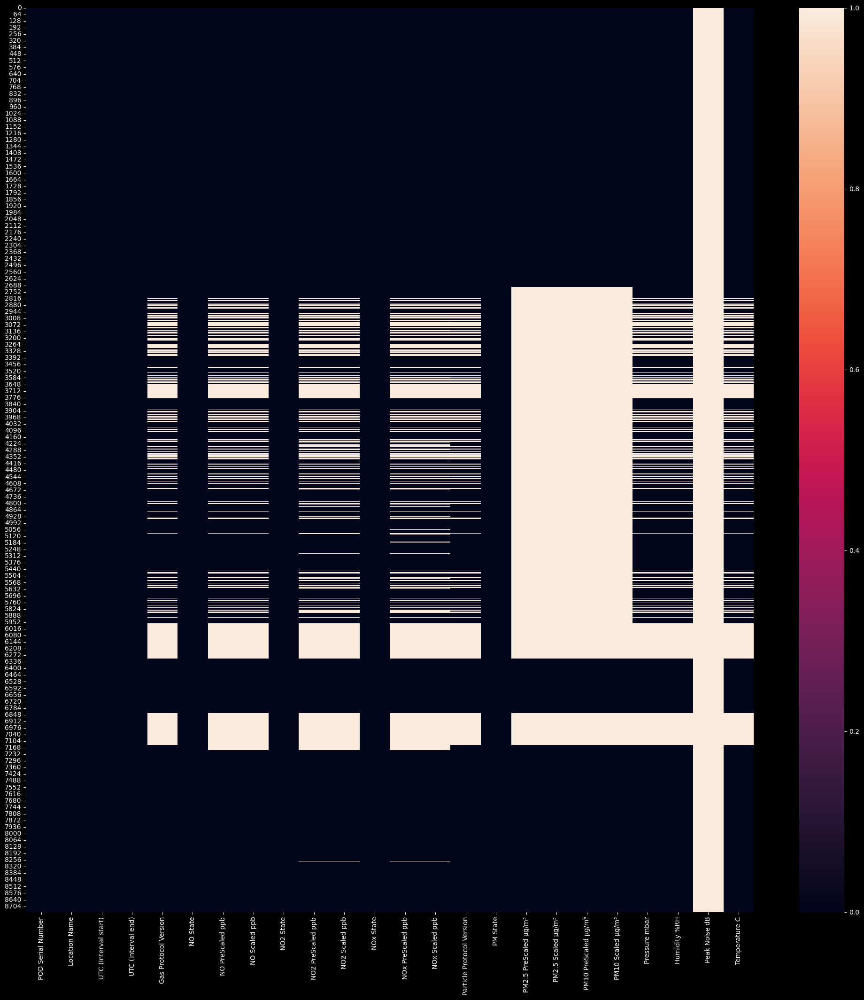

In [9]:
plt.figure(figsize=(25,25))
sns.heatmap(DF.isnull())
'''
The code `plt.figure(figsize=(25,25))` sets the figure size for the plot.
The next line `sns.heatmap(data.isnull())` creates a heatmap visualization of␣
↪the missing values in the dataset
using the seaborn library.
'''

In [10]:
DF=DF.drop(['Peak Noise dB'], axis=1)
DF.reset_index(drop=True, inplace=True)

In [11]:
missing_value_percent = DF.isnull().sum() / DF.shape[0] * 100
print(missing_value_percent)
# The code calculates the percentage of missing values in each column of the␣dataset and then prints the resulting percentages.

POD Serial Number             0.000000
Location Name                 0.000000
UTC (Interval start)          0.000000
UTC (Interval end)            0.000000
Gas Protocol Version         18.413242
NO State                      0.000000
NO PreScaled ppb             18.972603
NO Scaled ppb                18.972603
NO2 State                     0.000000
NO2 PreScaled ppb            19.794521
NO2 Scaled ppb               19.794521
NOx State                     0.000000
NOx PreScaled ppb            19.920091
NOx Scaled ppb               19.920091
Particle Protocol Version    18.401826
PM State                      0.000000
PM2.5 PreScaled µg/m³        44.634703
PM2.5 Scaled µg/m³           44.634703
PM10 PreScaled µg/m³         44.634703
PM10 Scaled µg/m³            44.634703
Pressure mbar                18.413242
Humidity %RH                 18.401826
Temperature C                18.401826
dtype: float64


from the above missing value percentage information we observe that the particles data has the most missing value percentage but since we are interested in understanding particles interaction, we will not drop this columns, to clean this data of missing values, we will drop only the rows with missing values.

In [12]:
numerical_DataFrame = DF.select_dtypes(include=['int64', 'float64'])
numerical_DataFrame.head(2)

,POD Serial Number,NO PreScaled ppb,NO Scaled ppb,NO2 PreScaled ppb,NO2 Scaled ppb,NOx PreScaled ppb,NOx Scaled ppb,PM2.5 PreScaled µg/m³,PM2.5 Scaled µg/m³,PM10 PreScaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C
0,2450005,1.29,1.29,19.22,19.22,20.51,20.51,51.21,51.21,66.34,66.34,1016.00,88.45,11.35
1,2450005,0.23,0.23,14.46,14.46,14.69,14.69,40.59,40.59,37.35,37.35,1015.43,88.60,11.80


In [13]:
numerical_DataFrame.shape

(8760, 14)

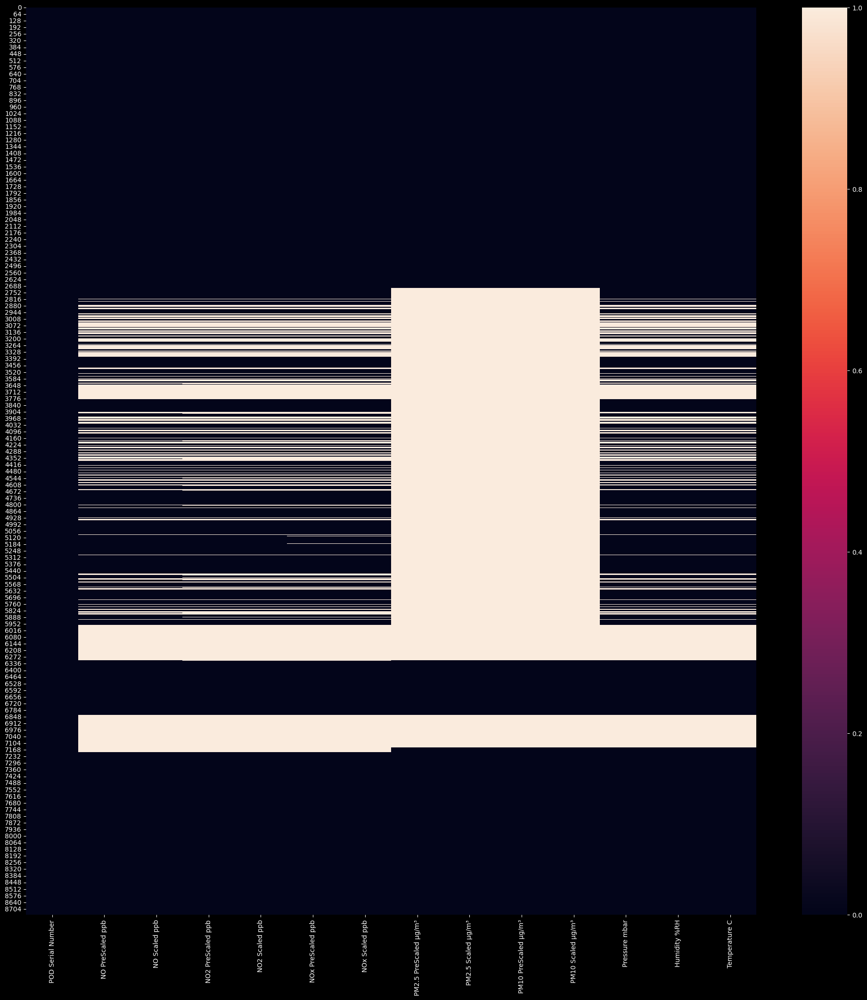

In [14]:
plt.figure(figsize=(25,25))
sns.heatmap(numerical_DataFrame.isnull())
plt.show()

In [15]:
#filtering the rows with null values
numerical_DataFrame_null_Rows = numerical_DataFrame[numerical_DataFrame.isnull().any(axis=1)]
numerical_DataFrame_null_Rows.head(5)

,POD Serial Number,NO PreScaled ppb,NO Scaled ppb,NO2 PreScaled ppb,NO2 Scaled ppb,NOx PreScaled ppb,NOx Scaled ppb,PM2.5 PreScaled µg/m³,PM2.5 Scaled µg/m³,PM10 PreScaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C
2706,2450005,2.67,2.67,16.67,16.67,19.34,19.34,NaN,NaN,NaN,NaN,1005.10,66.53,7.20
2707,2450005,2.08,2.08,17.64,17.64,19.72,19.72,NaN,NaN,NaN,NaN,1004.43,66.83,7.15
2708,2450005,1.75,1.75,17.72,17.72,19.48,19.48,NaN,NaN,NaN,NaN,1003.98,67.85,7.10
2709,2450005,2.63,2.63,17.36,17.36,19.99,19.99,NaN,NaN,NaN,NaN,1004.10,68.23,6.90
2710,2450005,2.43,2.43,18.16,18.16,20.59,20.59,NaN,NaN,NaN,NaN,1003.70,69.68,5.95


In [16]:
num_DF_MissingValue = numerical_DataFrame.isnull().sum()
print(num_DF_MissingValue)

POD Serial Number           0
NO PreScaled ppb         1662
NO Scaled ppb            1662
NO2 PreScaled ppb        1734
NO2 Scaled ppb           1734
NOx PreScaled ppb        1745
NOx Scaled ppb           1745
PM2.5 PreScaled µg/m³    3910
PM2.5 Scaled µg/m³       3910
PM10 PreScaled µg/m³     3910
PM10 Scaled µg/m³        3910
Pressure mbar            1613
Humidity %RH             1612
Temperature C            1612
dtype: int64


In [17]:
num_DF_MissingValue_columns = num_DF_MissingValue[num_DF_MissingValue > 0].keys()
print(num_DF_MissingValue_columns)

Index(['NO PreScaled ppb', 'NO Scaled ppb', 'NO2 PreScaled ppb',
       'NO2 Scaled ppb', 'NOx PreScaled ppb', 'NOx Scaled ppb',
       'PM2.5 PreScaled µg/m³', 'PM2.5 Scaled µg/m³', 'PM10 PreScaled µg/m³',
       'PM10 Scaled µg/m³', 'Pressure mbar', 'Humidity %RH', 'Temperature C'],
      dtype='object')


In [18]:
numerical_DataFrame = numerical_DataFrame.dropna()

C:\Users\User\AppData\Local\Temp\ipykernel_11448\3451582054.py:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(numerical_DataFrame[var], bins=20, kde_kws={'linewidth': 2, 'color': '#DC143C'})
C:\Users\User\AppData\Local\Temp\ipykernel_11448\3451582054.py:10: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

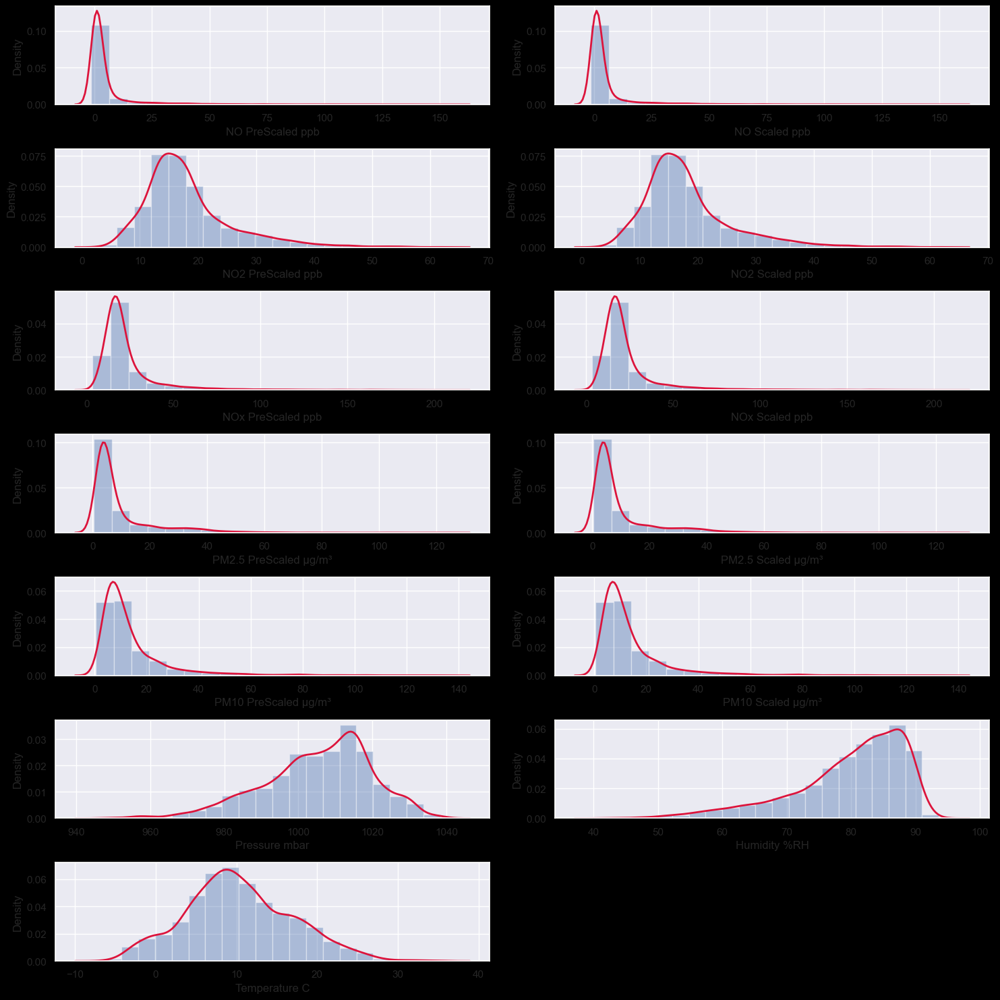

In [19]:
# Visualization of Missing Numeric Data Distribution
plt.figure(figsize=(15,15))
sns.set()

num_variables = len(num_DF_MissingValue_columns)
num_rows = (num_variables - 1) // 2 + 1

for i, var in enumerate(num_DF_MissingValue_columns):
    plt.subplot(num_rows, 2, i+1)
    sns.distplot(numerical_DataFrame[var], bins=20, kde_kws={'linewidth': 2, 'color': '#DC143C'})

plt.tight_layout()  
plt.show()

## Preliminary data cleaning

In [20]:


#deleting missing values rows
DF2=DF.dropna()



In [21]:


DF2.shape



(4798, 23)

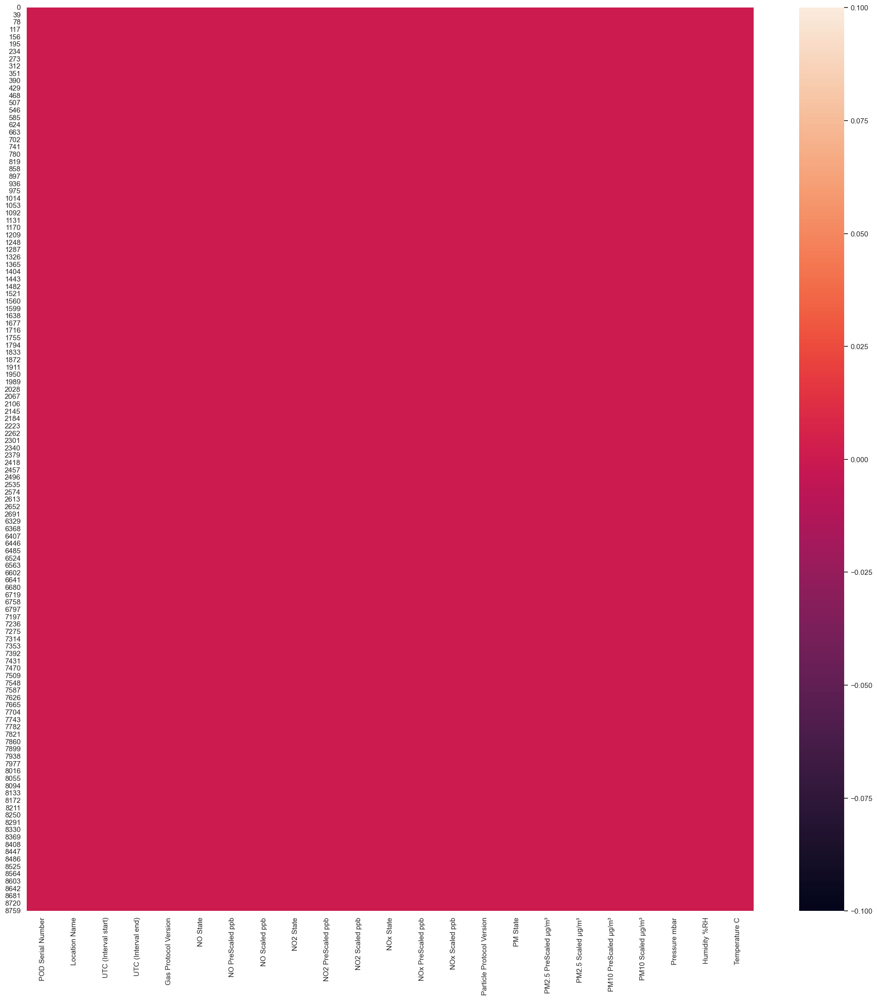

In [22]:
plt.figure(figsize=(25,25))
sns.heatmap(DF2.isnull())
plt.show()
# This heatmap creates a visualization of missing values after dropping rows.

with our clean data as observed from the figure above we can now begin the process of data exploration

In [23]:
DF2.isnull().sum().sum() # Here, we can see that our DatFrame doesn't contain␣ant null values.

0

Here we observe that we have dealt with missing values hence our data does not contain missing values anymore.


In [24]:
DF2.select_dtypes(include=['int64','float64']).columns # Cheking the column␣names of numerical DataFrame.

Index(['POD Serial Number', 'NO PreScaled ppb', 'NO Scaled ppb',
       'NO2 PreScaled ppb', 'NO2 Scaled ppb', 'NOx PreScaled ppb',
       'NOx Scaled ppb', 'PM2.5 PreScaled µg/m³', 'PM2.5 Scaled µg/m³',
       'PM10 PreScaled µg/m³', 'PM10 Scaled µg/m³', 'Pressure mbar',
       'Humidity %RH', 'Temperature C'],
      dtype='object')

In [25]:
num_var=['NO PreScaled ppb', 'NO Scaled ppb',
       'NO2 PreScaled ppb', 'NO2 Scaled ppb', 'NOx PreScaled ppb',
       'NOx Scaled ppb', 'Pressure mbar', 'Humidity %RH', 'Temperature C']

C:\Users\User\AppData\Local\Temp\ipykernel_11448\4101484424.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(DF[var], bins=20)
C:\Users\User\AppData\Local\Temp\ipykernel_11448\4101484424.py:8: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(DF2[var], bins=20)
C:\Users\User\AppData\Local\Temp\ip

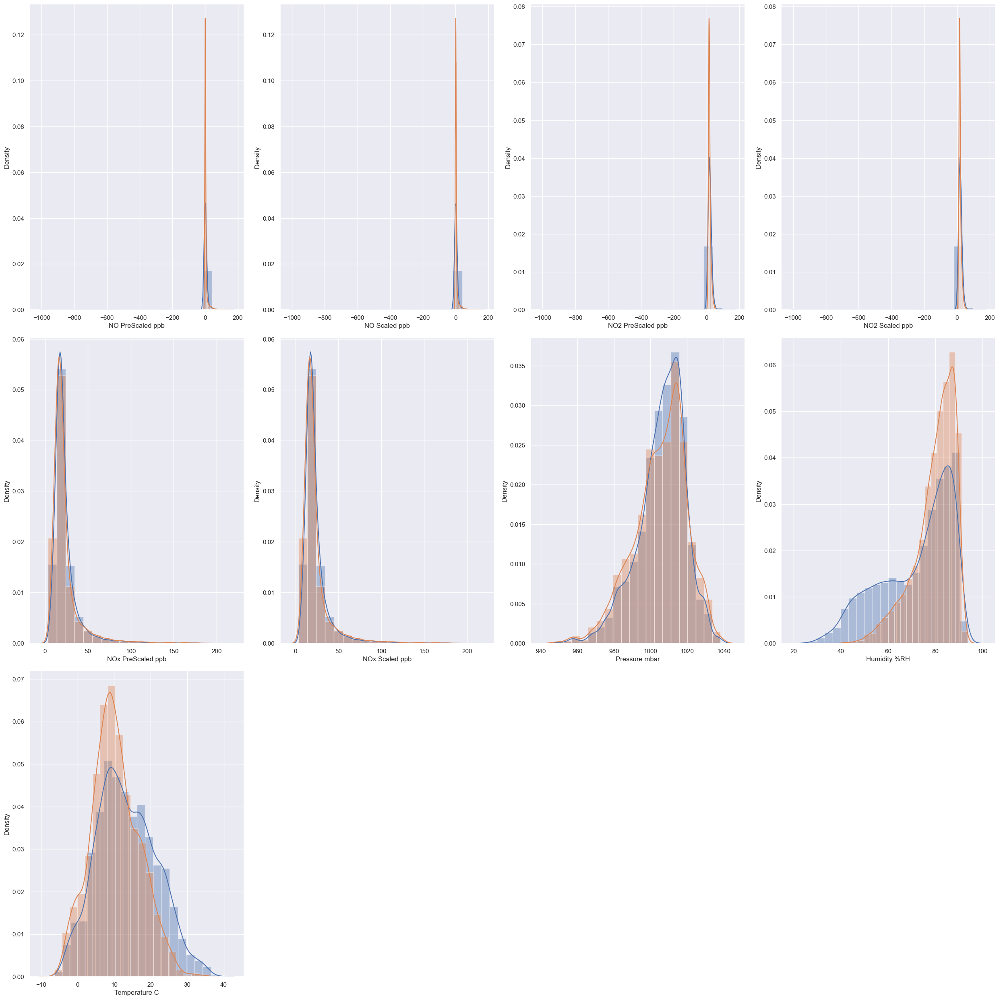

In [26]:
plt.figure(figsize=(25,25))
# Calculate the number of rows and columns for the subplots
num_rows = (len(num_var) + 3) // 4 # Adjusting the number of columns as needed
num_cols = 4
for i, var in enumerate(num_var):
     plt.subplot(num_rows, num_cols, i+1)
     sns.distplot(DF[var], bins=20)
     sns.distplot(DF2[var], bins=20)
plt.tight_layout() # Optional: Adjusts the spacing between subplots
plt.show()

from the data visualization above, it is clear that data cleaning has not changed the mode of data distribution, hence the distribution of the final data and the intitial data is similar.


Removal reduntantant columns

#Data inspection


In [27]:
DF2.head(5)

,POD Serial Number,Location Name,UTC (Interval start),UTC (Interval end),Gas Protocol Version,NO State,NO PreScaled ppb,NO Scaled ppb,NO2 State,NO2 PreScaled ppb,NO2 Scaled ppb,NOx State,NOx PreScaled ppb,NOx Scaled ppb,Particle Protocol Version,PM State,PM2.5 PreScaled µg/m³,PM2.5 Scaled µg/m³,PM10 PreScaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C
0,2450005,Pod 2450005,13/Nov/2022 00:00:00,13/Nov/2022 01:00:00,V5.3.1,Reading,1.29,1.29,Reading,19.22,19.22,OK,20.51,20.51,v3.0,Deliquescence,51.21,51.21,66.34,66.34,1016.00,88.45,11.35
1,2450005,Pod 2450005,13/Nov/2022 01:00:00,13/Nov/2022 02:00:00,V5.3.1,Reading,0.23,0.23,Reading,14.46,14.46,OK,14.69,14.69,v3.0,OK,40.59,40.59,37.35,37.35,1015.43,88.60,11.80
2,2450005,Pod 2450005,13/Nov/2022 02:00:00,13/Nov/2022 03:00:00,V5.3.1,Reading,1.39,1.39,Reading,12.29,12.29,OK,13.68,13.68,v3.0,OK,34.94,34.94,29.36,29.36,1014.53,88.65,12.00
3,2450005,Pod 2450005,13/Nov/2022 03:00:00,13/Nov/2022 04:00:00,V5.3.1,Reading,0.58,0.58,Reading,12.30,12.30,OK,12.88,12.88,v3.0,OK,30.73,30.73,24.28,24.28,1014.73,88.48,12.18
4,2450005,Pod 2450005,13/Nov/2022 04:00:00,13/Nov/2022 05:00:00,V5.3.1,Reading,1.08,1.08,Reading,12.03,12.03,OK,13.12,13.12,v3.0,OK,31.17,31.17,24.50,24.50,1014.58,88.48,12.15


In [28]:
import pandas_profiling
#profile = pandas_profiling.ProfileReport(DF2)

# Display the profile report as widgets in Jupyter Notebook
#profile.to_widgets()

C:\Users\User\AppData\Local\Temp\ipykernel_11448\3256634580.py:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  import pandas_profiling


In [29]:
DF3=DF2.drop(['POD Serial Number', 'Gas Protocol Version', 'NO State', 'NO PreScaled ppb', 'NO2 State', 'NO2 PreScaled ppb', 'NOx PreScaled ppb', 'Particle Protocol Version', 'PM10 PreScaled µg/m³', 'PM2.5 PreScaled µg/m³'], axis=1)

In [30]:
DF3.head(5)

,Location Name,UTC (Interval start),UTC (Interval end),NO Scaled ppb,NO2 Scaled ppb,NOx State,NOx Scaled ppb,PM State,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C
0,Pod 2450005,13/Nov/2022 00:00:00,13/Nov/2022 01:00:00,1.29,19.22,OK,20.51,Deliquescence,51.21,66.34,1016.00,88.45,11.35
1,Pod 2450005,13/Nov/2022 01:00:00,13/Nov/2022 02:00:00,0.23,14.46,OK,14.69,OK,40.59,37.35,1015.43,88.60,11.80
2,Pod 2450005,13/Nov/2022 02:00:00,13/Nov/2022 03:00:00,1.39,12.29,OK,13.68,OK,34.94,29.36,1014.53,88.65,12.00
3,Pod 2450005,13/Nov/2022 03:00:00,13/Nov/2022 04:00:00,0.58,12.30,OK,12.88,OK,30.73,24.28,1014.73,88.48,12.18
4,Pod 2450005,13/Nov/2022 04:00:00,13/Nov/2022 05:00:00,1.08,12.03,OK,13.12,OK,31.17,24.50,1014.58,88.48,12.15


In [31]:
DF3.tail(2)

,Location Name,UTC (Interval start),UTC (Interval end),NO Scaled ppb,NO2 Scaled ppb,NOx State,NOx Scaled ppb,PM State,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C
8758,Pod 2450005,12/Nov/2023 22:00:00,12/Nov/2023 23:00:00,0.35,24.62,OK,24.97,OK,16.39,25.55,996.2,88.08,9.38
8759,Pod 2450005,12/Nov/2023 23:00:00,13/Nov/2023 00:00:00,0.65,20.78,OK,21.43,OK,13.29,22.03,996.1,88.38,9.45


In [32]:
#from the data columns we will drop the start interval column since there is no much information that can be retrieved from the data and keep the end interval time
DF3=DF3.drop(['UTC (Interval end)'], axis=1)
DF3.reset_index(drop=True, inplace=True)#Reseting the data index

In [33]:
#converting the time column to a datetime column and renaming the column to 'Datetime'
DF3['Datetime']=pd.to_datetime(DF3['UTC (Interval start)'])
DF3.reset_index(drop=True, inplace=True)

In [34]:
#dropping the 'Project Time (Interval end) (UTC0)' column
DF3=DF3.drop(['UTC (Interval start)'], axis=1)
DF3.reset_index(drop=True, inplace=True)

In [35]:
DF3['Datetime'] = pd.to_datetime(DF3['Datetime'])

In [36]:
DF3.head(2)

,Location Name,NO Scaled ppb,NO2 Scaled ppb,NOx State,NOx Scaled ppb,PM State,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,Datetime
0,Pod 2450005,1.29,19.22,OK,20.51,Deliquescence,51.21,66.34,1016.00,88.45,11.35,2022-11-13 00:00:00
1,Pod 2450005,0.23,14.46,OK,14.69,OK,40.59,37.35,1015.43,88.60,11.80,2022-11-13 01:00:00


In [37]:
DF3.dtypes

Location Name                 object
NO Scaled ppb                float64
NO2 Scaled ppb               float64
NOx State                     object
NOx Scaled ppb               float64
PM State                      object
PM2.5 Scaled µg/m³           float64
PM10 Scaled µg/m³            float64
Pressure mbar                float64
Humidity %RH                 float64
Temperature C                float64
Datetime              datetime64[ns]
dtype: object

In [38]:
DF3['Datetime'].dtype

dtype('<M8[ns]')

In [39]:
np.dtype('datetime64[ns]') == np.dtype('<M8[ns]')

True

In [40]:
#investigating our data for consistency
DF3.head(2)

,Location Name,NO Scaled ppb,NO2 Scaled ppb,NOx State,NOx Scaled ppb,PM State,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,Datetime
0,Pod 2450005,1.29,19.22,OK,20.51,Deliquescence,51.21,66.34,1016.00,88.45,11.35,2022-11-13 00:00:00
1,Pod 2450005,0.23,14.46,OK,14.69,OK,40.59,37.35,1015.43,88.60,11.80,2022-11-13 01:00:00


In [41]:
#we also drop the location column since it provides no information
DF3=DF3.drop(['Location Name'], axis=1)
DF3.reset_index(drop=True, inplace=True)

In [42]:
#we then profile our data to learn of the newly cleaned data
profile1 = pandas_profiling.ProfileReport(DF3)

# Display the profile report as widgets in Jupyter Notebook
profile1.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

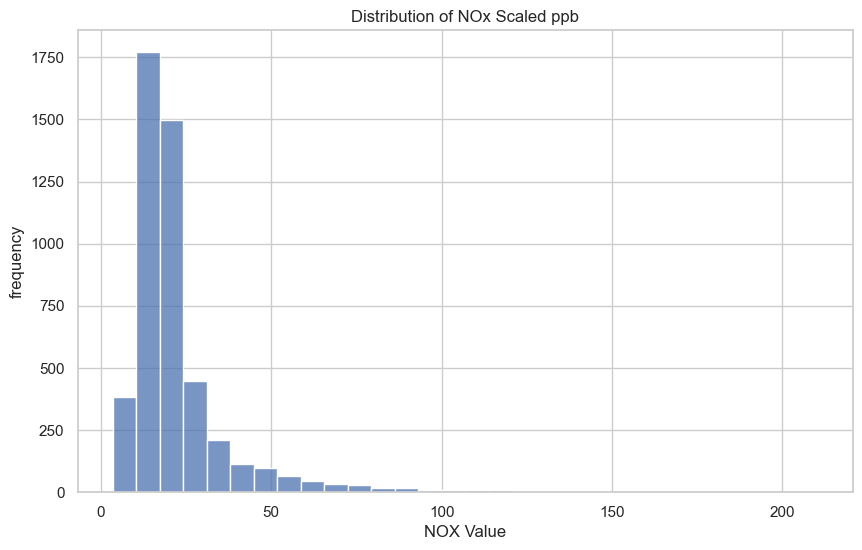

In [43]:
# taking NOX as the overall Nitogen oxides pollutants we ask ourselves how is the pollutant distributed monthly,
#we use the following code to investigate
#set the style of seaborn
sns.set(style='whitegrid')

plt.figure(figsize=(10, 6))
sns.histplot(DF3['NOx Scaled ppb'], kde=False, bins=30)
plt.title('Distribution of NOx Scaled ppb')
plt.xlabel('NOX Value')
plt.ylabel('frequency')
plt.show()

From the graph, 0-25 values are the most frequent NOX values, they form about 75% of the values, 25-50, form about 10%, the high values from 50 and above form the rest of the percentage.

C:\Users\User\AppData\Local\Temp\ipykernel_11448\2987480521.py:7: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  pollution_data_resampled = DF3.set_index('Datetime').resample('M').mean()


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 [Text(0, 0, '2022-11-30 00:00:00'),
  Text(1, 0, '2022-12-31 00:00:00'),
  Text(2, 0, '2023-01-31 00:00:00'),
  Text(3, 0, '2023-02-28 00:00:00'),
  Text(4, 0, '2023-03-31 00:00:00'),
  Text(5, 0, '2023-04-30 00:00:00'),
  Text(6, 0, '2023-05-31 00:00:00'),
  Text(7, 0, '2023-06-30 00:00:00'),
  Text(8, 0, '2023-07-31 00:00:00'),
  Text(9, 0, '2023-08-31 00:00:00'),
  Text(10, 0, '2023-09-30 00:00:00'),
  Text(11, 0, '2023-10-31 00:00:00'),
  Text(12, 0, '2023-11-30 00:00:00')])

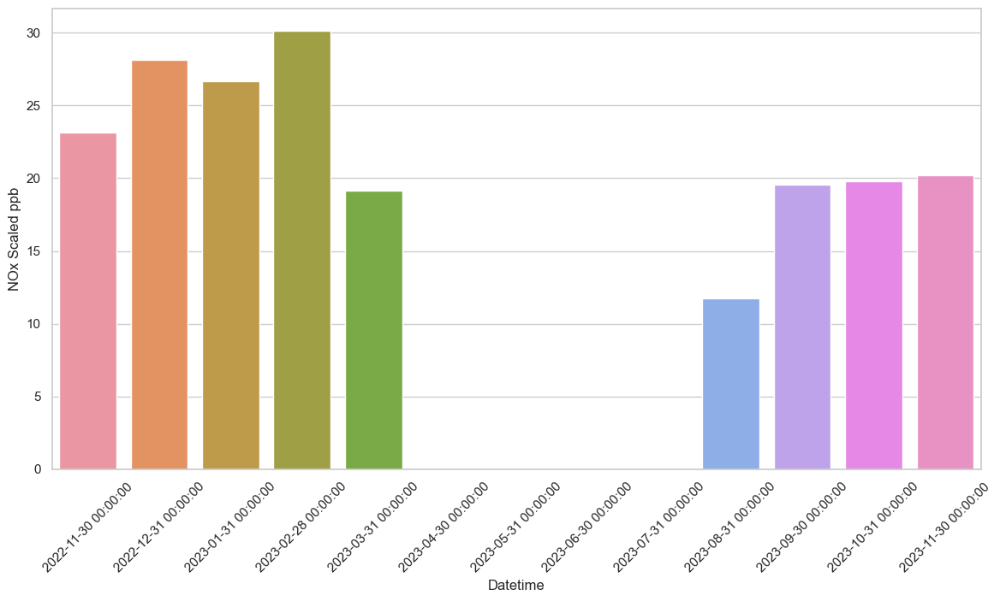

In [44]:
#getting the monthly mean of NOX
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(14, 7))

pollution_data_resampled = DF3.set_index('Datetime').resample('M').mean()

# Plot for 'NOx Scaled ppb'
sns.barplot(data=pollution_data_resampled, x=pollution_data_resampled.index, y='NOx Scaled ppb', label='NOx')
plt.xticks(rotation=45)

from the monthly mean of NOX, the available data for NOX are only for 9 months, of these 2022 has more NOX pollutant than 2023, this is evident from NOvember 2022 and 2023 averages respectively.
NOX pollutants are lowest during the holiday months, between July and august. the rate of NOX pollution rises from end of august steadly reaching its first peak at the end of December, followed by a slight drop before rising to all time peak between in Janury to february, with a final drop from the to the first period lowest in match, as seen above. 

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 [Text(0, 0, '2022-11-30 00:00:00'),
  Text(1, 0, '2022-12-31 00:00:00'),
  Text(2, 0, '2023-01-31 00:00:00'),
  Text(3, 0, '2023-02-28 00:00:00'),
  Text(4, 0, '2023-03-31 00:00:00'),
  Text(5, 0, '2023-04-30 00:00:00'),
  Text(6, 0, '2023-05-31 00:00:00'),
  Text(7, 0, '2023-06-30 00:00:00'),
  Text(8, 0, '2023-07-31 00:00:00'),
  Text(9, 0, '2023-08-31 00:00:00'),
  Text(10, 0, '2023-09-30 00:00:00'),
  Text(11, 0, '2023-10-31 00:00:00'),
  Text(12, 0, '2023-11-30 00:00:00')])

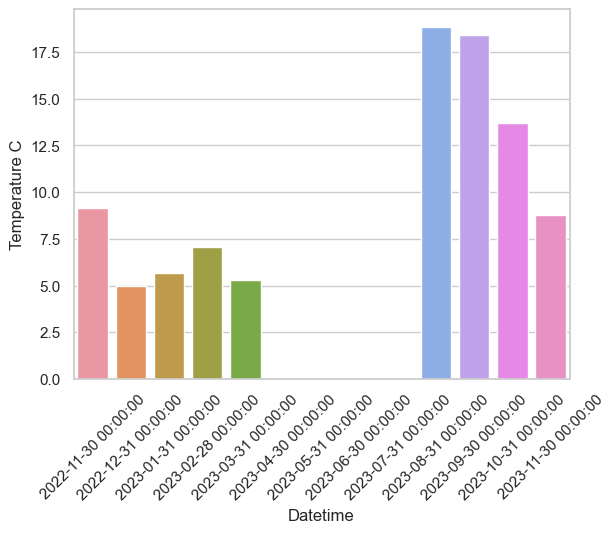

In [45]:
#we know temperature is negatively correlated to NOX as seen from the data profiling to observe if temperature played a major role in the rise and fall of the average nox, we plot average temperature 
#bargraph over the same period
# Plot for 'NOx Scaled ppb'
sns.barplot(data=pollution_data_resampled, x=pollution_data_resampled.index, y='Temperature C', label='Temperature')
plt.xticks(rotation=45)

the bargraph indicates a strong negative correlation between Temperature and NOX. however there is a is unexplained rise between January and february. within this months the temperatures are relatively high and NOX emission is also high, we will investigate the sudden change in relation on a later stage. we can therefore generalize that during months of low temperatures the rates of NOX volumes are generally high, while periods of school holidays the rate of NOX emission volumes are lowest, having understood the general relationship, we now want to shift our focus to Nitrogen Dioxide since is one of the major pollutant, to perfom this, we need to first understand NO2 distribution as shown in figure below.

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 [Text(0, 0, '2022-11-30 00:00:00'),
  Text(1, 0, '2022-12-31 00:00:00'),
  Text(2, 0, '2023-01-31 00:00:00'),
  Text(3, 0, '2023-02-28 00:00:00'),
  Text(4, 0, '2023-03-31 00:00:00'),
  Text(5, 0, '2023-04-30 00:00:00'),
  Text(6, 0, '2023-05-31 00:00:00'),
  Text(7, 0, '2023-06-30 00:00:00'),
  Text(8, 0, '2023-07-31 00:00:00'),
  Text(9, 0, '2023-08-31 00:00:00'),
  Text(10, 0, '2023-09-30 00:00:00'),
  Text(11, 0, '2023-10-31 00:00:00'),
  Text(12, 0, '2023-11-30 00:00:00')])

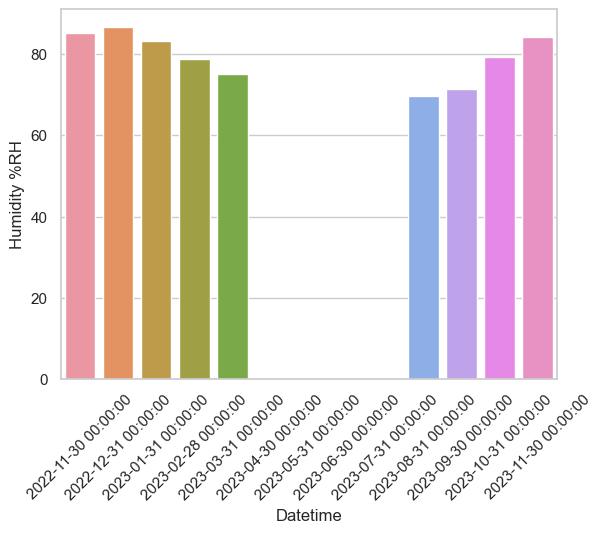

In [46]:
sns.barplot(data=pollution_data_resampled, x=pollution_data_resampled.index, y='Humidity %RH', label='Humidity')
plt.xticks(rotation=45)

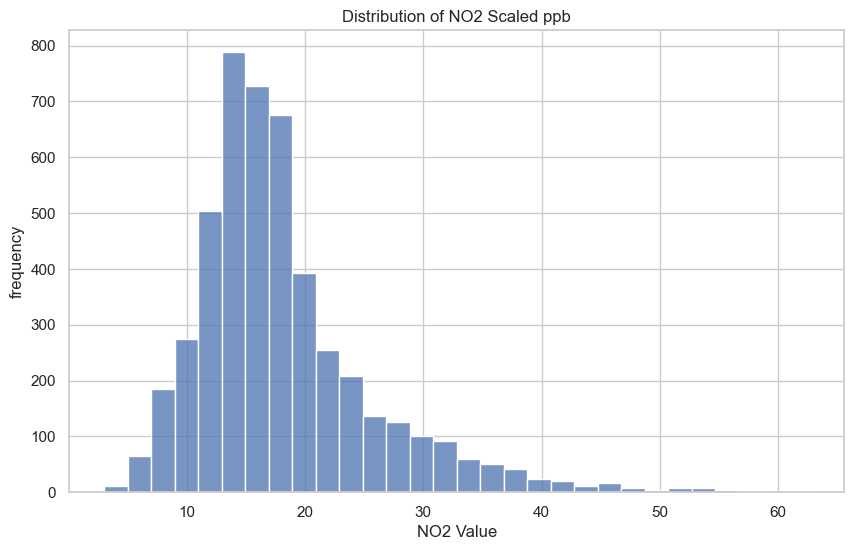

In [47]:
sns.set(style='whitegrid')

plt.figure(figsize=(10, 6))
sns.histplot(DF3['NO2 Scaled ppb'], kde=False, bins=30)
plt.title('Distribution of NO2 Scaled ppb')
plt.xlabel('NO2 Value')
plt.ylabel('frequency')
plt.show()

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 [Text(0, 0, '2022-11-30 00:00:00'),
  Text(1, 0, '2022-12-31 00:00:00'),
  Text(2, 0, '2023-01-31 00:00:00'),
  Text(3, 0, '2023-02-28 00:00:00'),
  Text(4, 0, '2023-03-31 00:00:00'),
  Text(5, 0, '2023-04-30 00:00:00'),
  Text(6, 0, '2023-05-31 00:00:00'),
  Text(7, 0, '2023-06-30 00:00:00'),
  Text(8, 0, '2023-07-31 00:00:00'),
  Text(9, 0, '2023-08-31 00:00:00'),
  Text(10, 0, '2023-09-30 00:00:00'),
  Text(11, 0, '2023-10-31 00:00:00'),
  Text(12, 0, '2023-11-30 00:00:00')])

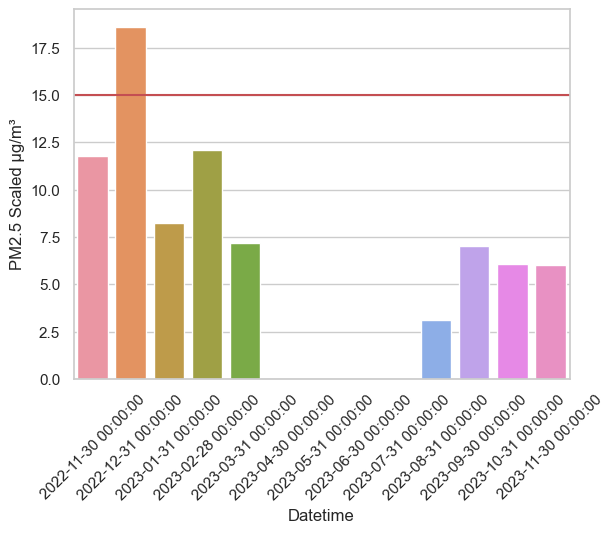

In [48]:
#plotting the average PM2.5
sns.barplot(data=pollution_data_resampled, x=pollution_data_resampled.index, y='PM2.5 Scaled µg/m³', label='PM2.5 Scaled µg/m³')
# Add the average line
plt.axhline(y=15, color='r', linestyle='-')
plt.xticks(rotation=45)

There is a general increase trend from november to december then uneven decrease trend to march, in the second part of the data there is an initial increase then gentle decrese as seen above.

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 [Text(0, 0, '2022-11-30 00:00:00'),
  Text(1, 0, '2022-12-31 00:00:00'),
  Text(2, 0, '2023-01-31 00:00:00'),
  Text(3, 0, '2023-02-28 00:00:00'),
  Text(4, 0, '2023-03-31 00:00:00'),
  Text(5, 0, '2023-04-30 00:00:00'),
  Text(6, 0, '2023-05-31 00:00:00'),
  Text(7, 0, '2023-06-30 00:00:00'),
  Text(8, 0, '2023-07-31 00:00:00'),
  Text(9, 0, '2023-08-31 00:00:00'),
  Text(10, 0, '2023-09-30 00:00:00'),
  Text(11, 0, '2023-10-31 00:00:00'),
  Text(12, 0, '2023-11-30 00:00:00')])

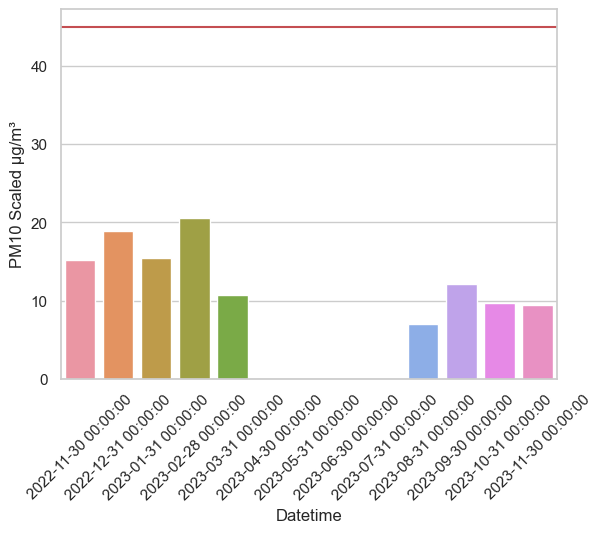

In [49]:
#plotting the average PM10
sns.barplot(data=pollution_data_resampled, x=pollution_data_resampled.index, y='PM10 Scaled µg/m³', label='PM10 Scaled µg/m³')
plt.axhline(y=45, color='r', linestyle='-')
plt.xticks(rotation=45)

In [50]:
DF3['HourOfDay'] = DF3['Datetime'].dt.hour
DF3['DayOfWeek'] = DF3['Datetime'].dt.dayofweek
DF3['DayOfMonth'] = DF3['Datetime'].dt.daysinmonth
DF3['Month'] = DF3['Datetime'].dt.days_in_month
DF3['Day'] = DF3['Datetime'].dt.day


In [51]:
DF3['Datetime'].dtype

dtype('<M8[ns]')

In [52]:
#creating a daily and a weekly average and daily average of seasons with higher pollution records, in our case from 31 jan to 28th feb
start_date ='2023-01-31'
end_date = '2023-02-28'

# Select data within the date range
Winter1 = DF3[(DF3['Datetime'] >= start_date) & (DF3['Datetime'] <= end_date)]
Winter1.reset_index(drop=True, inplace=True)

In [53]:

hourly_emission = Winter1.groupby('HourOfDay')[['NO Scaled ppb', 'NO2 Scaled ppb', 'PM2.5 Scaled µg/m³', 'PM10 Scaled µg/m³', 'Pressure mbar', 'Humidity %RH', 'Temperature C']].mean().reset_index()

#weekly_emission
weekly_emission = Winter1.groupby('DayOfWeek')[['NO Scaled ppb', 'NO2 Scaled ppb', 'PM2.5 Scaled µg/m³', 'PM10 Scaled µg/m³', 'Pressure mbar', 'Humidity %RH', 'Temperature C']].mean().reset_index()


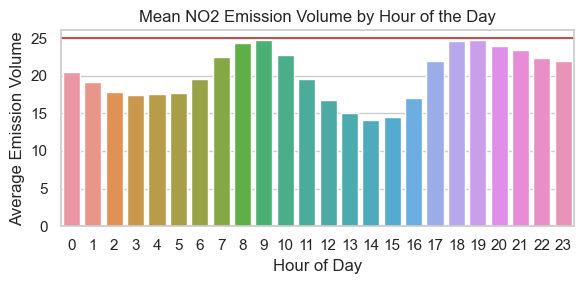

In [54]:
# Set the figure size
plt.figure(figsize=(6, 3))

# List of pollutants
pollutant = 'NO2'

# Plot the bar chart
sns.barplot(x='HourOfDay', y=f'{pollutant} Scaled ppb', data=hourly_emission)

# Set titles and labels
plt.title(f'Mean {pollutant} Emission Volume by Hour of the Day')
plt.xlabel('Hour of Day')
plt.ylabel('Average Emission Volume')
plt.xticks(np.arange(0, 24, 1))

# Add a red horizontal line
plt.axhline(y=25, color='r', linestyle='-')

# Adjust layout to prevent overlapping
plt.tight_layout()

# Show the plot
plt.show()

The busiest days of the week is tuesday with the highest emission, NOX emission volumes decreses gently with small activity on friday to the lowest measured volumes of the period between Sartuday and Sunday

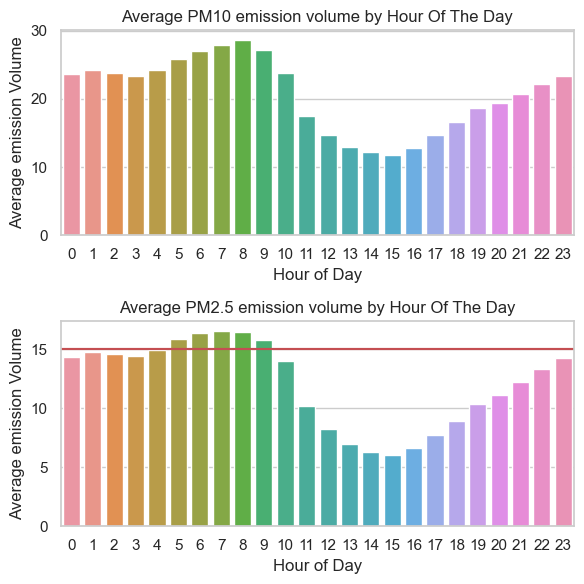

In [55]:
# Set the figure size
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(6, 6))

# List of pollutants
pollutants = ['PM10', 'PM2.5']

# Plot each bar chart on its own subplot
for i, pollutant in enumerate(pollutants):
    sns.barplot(x='HourOfDay', y=f'{pollutant} Scaled µg/m³', data=hourly_emission, ax=axes[i])
    axes[i].set_title(f'Average {pollutant} emission volume by Hour Of The Day')
    axes[i].set_xlabel('Hour of Day')
    axes[i].set_ylabel('Average emission Volume')
    axes[i].set_xticks(np.arange(0, 24, 1))

# Adjust layout to prevent overlapping
    plt.axhline(y=15, color='r', linestyle='-')
plt.tight_layout()

# Show the plots
plt.show()

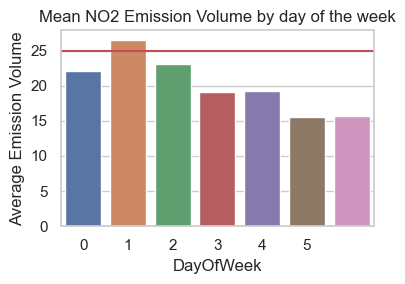

In [56]:


# Set the figure size
plt.figure(figsize=(4, 3))

# List of pollutants
pollutant = 'NO2'

# Plot the bar chart
sns.barplot(x='DayOfWeek', y=f'{pollutant} Scaled ppb', data=weekly_emission)

# Set titles and labels
plt.title(f'Mean {pollutant} Emission Volume by day of the week')
plt.xlabel('DayOfWeek')
plt.ylabel('Average Emission Volume')
plt.xticks(np.arange(0, 6, 1))

# Add a red horizontal line
plt.axhline(y=25, color='r', linestyle='-')

# Adjust layout to prevent overlapping
plt.tight_layout()

# Show the plot
plt.show()

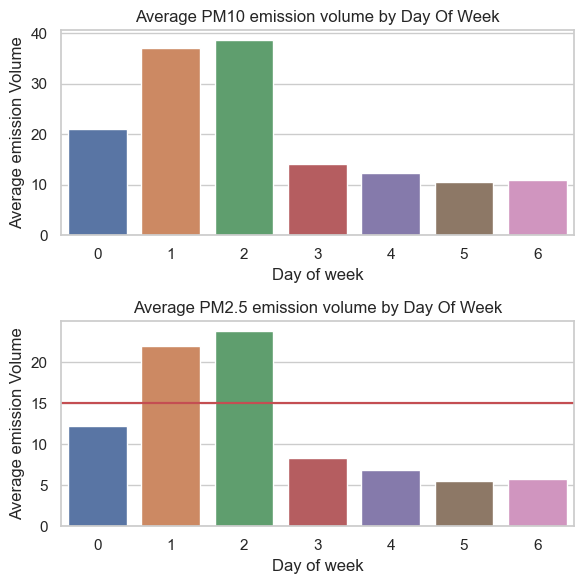

In [57]:
#weekly
# Set the figure size
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(6, 6))

# List of pollutants
pollutants = ['PM10', 'PM2.5']

# Plot each bar chart on its own subplot
for i, pollutant in enumerate(pollutants):
    sns.barplot(x='DayOfWeek', y=f'{pollutant} Scaled µg/m³', data=weekly_emission, ax=axes[i])
    axes[i].set_title(f'Average {pollutant} emission volume by Day Of Week')
    axes[i].set_xlabel('Day of week')
    axes[i].set_ylabel('Average emission Volume')
    axes[i].set_xticks(np.arange(0, 7, 1))
    plt.axhline(y=15, color='r', linestyle='-')

# Adjust layout to prevent overlapping
plt.tight_layout()

# Show the plots
plt.show()

From the figure PM2.5 can partly be explained by vehicler patterns but to a neglible extend, however, PM2.5 rise steadly from 00:00 hours to the peak at 08:00 hours, then drops slightly followed by a sharp drop to the period lowest at 16:00 hours, then a consequent steady rise to 00:00 and the circles continues. This is an indication that apart from the day activity there is also other factors that contribute to the rates of PM2.5 emission. to explore other factors contributing to the nature of PM2.5 distribution, we create a figure the average temperatures daily temperature and compare as seen below.

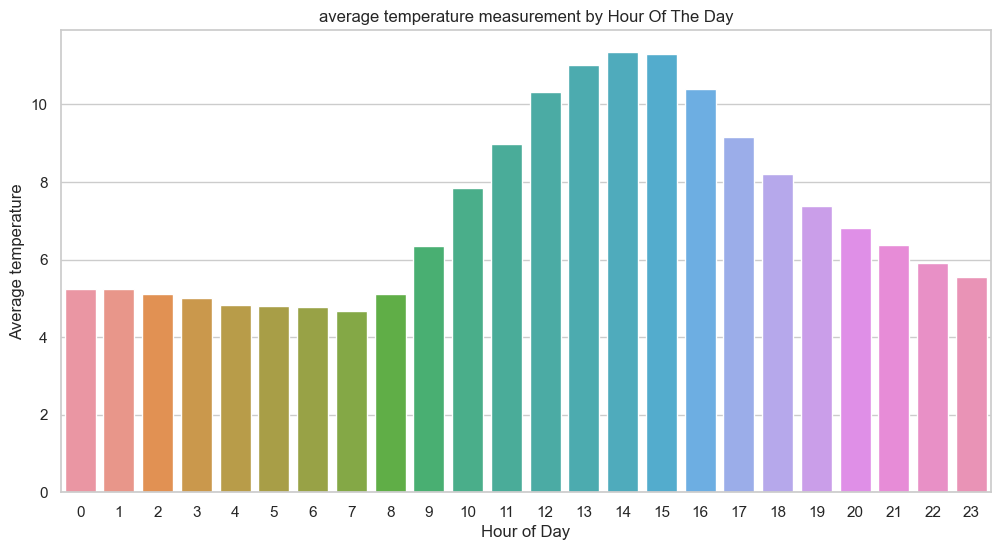

In [58]:
#plotting the hourly emission temperature

plt.figure(figsize=(12, 6))
sns.barplot(x='HourOfDay', y='Temperature C', data=hourly_emission)
plt.title('average temperature measurement by Hour Of The Day')
plt.xlabel('Hour of Day')
plt.ylabel('Average temperature')
plt.xticks(np.arange(0, 24, 1))
plt.show()

In [59]:
import altair as alt
alt.Chart(Winter1).mark_point().encode(
    x='PM10 Scaled µg/m³',
    y='Temperature C',
).properties(
    width= 400,
    height=200
)

alt.Chart(...)

from the figure a negative correlation is observed between Temperature and PM10 as seen above.

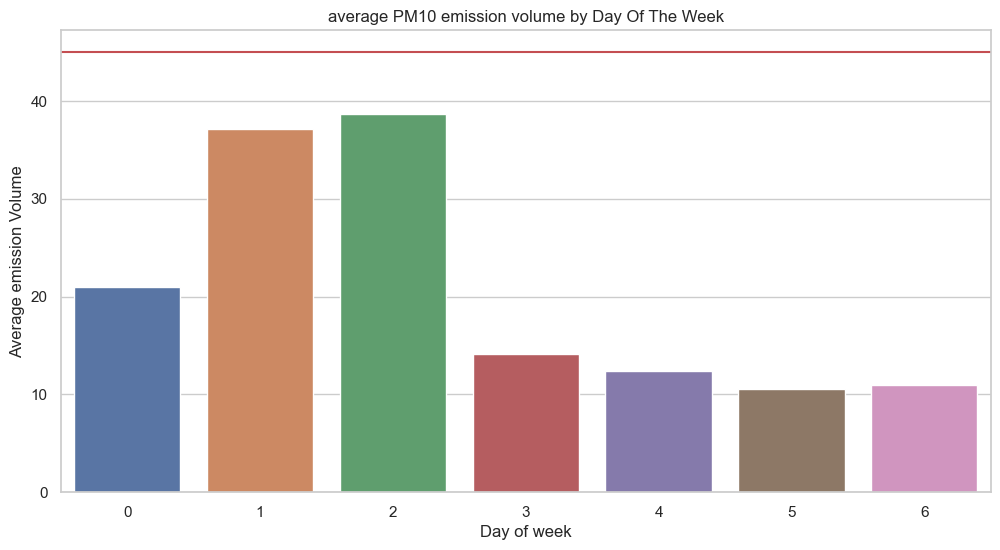

In [60]:
#creating a weekly observation graph for PM10

plt.figure(figsize=(12, 6))
sns.barplot(x='DayOfWeek', y='PM10 Scaled µg/m³', data=weekly_emission)
plt.title('average PM10 emission volume by Day Of The Week')
plt.xlabel('Day of week')
plt.ylabel('Average emission Volume')
plt.axhline(y=45, color='r', linestyle='-')
plt.xticks(np.arange(0, 7, 1))
plt.show()

The bar graph above shows a 1:1 similarity with PM2.5 graph, therefore we can conclude that PM2.5 is positively correlated with PM10. 

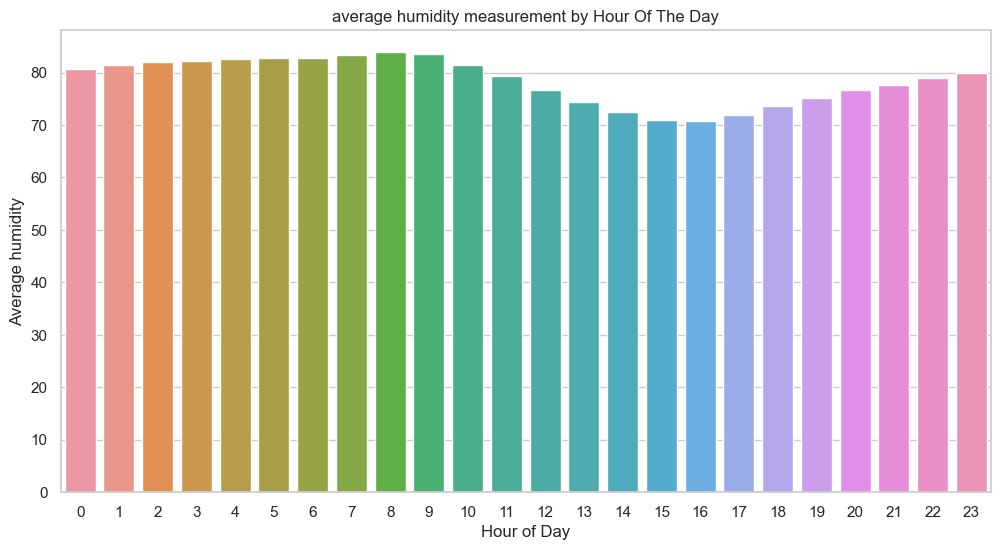

In [61]:
#creating the graph of average humidity
plt.figure(figsize=(12, 6))
sns.barplot(x='HourOfDay', y='Humidity %RH', data=hourly_emission)
plt.title('average humidity measurement by Hour Of The Day')
plt.xlabel('Hour of Day')
plt.ylabel('Average humidity')
plt.xticks(np.arange(0, 24, 1))
plt.show()

humidity at 00:00 is relatively high, the volumes increase constantly to peak at 10:00 then slops and drops to 18:00, where the volume increases again constantly. the rise and fall in volumes of humidity shows a high similarity with that in PM10, and PM2.5. to investigate the relationship between humidity and PM, we plot the graph of PM2.5 against humidity as shown below.

In [62]:
import altair as alt
alt.Chart(Winter1).mark_point().encode(
    y='PM10 Scaled µg/m³',
    x='Humidity %RH',
).properties(
    width= 400,
    height=200
)

alt.Chart(...)

from the graph, PM10 and humidity have a positive correlation. however, all PM values are prevelant at high humidity as seen above, therefore we can conclude that high humidity values have a positive correlation with PM.

In [63]:
alt.Chart(Winter1).mark_point().encode(
    x='PM10 Scaled µg/m³',
    y='NO2 Scaled ppb',
).properties(
    width= 400,
    height=200
)

alt.Chart(...)

The average weekly humidity was high throughout the weeks as seen in the bargraph above.

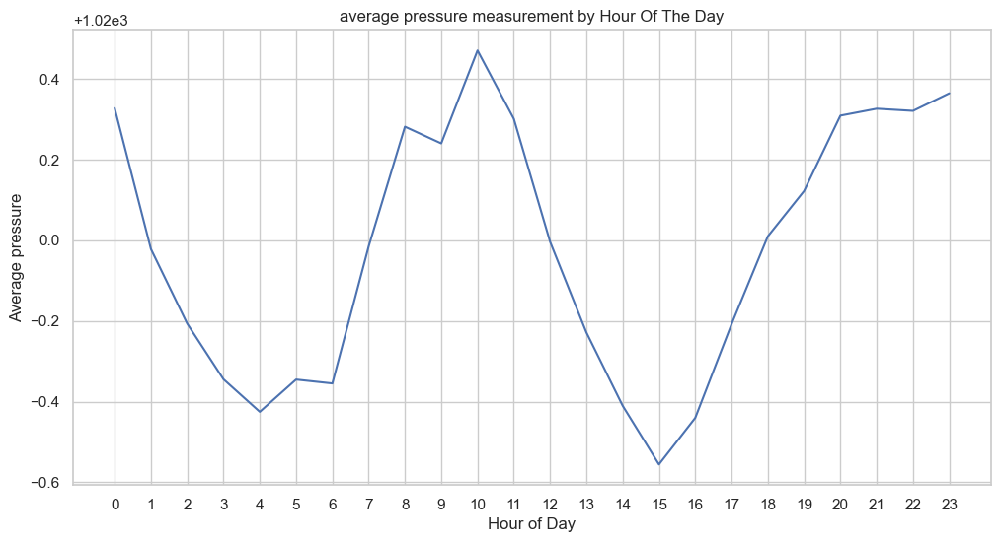

In [64]:
#creating the graph of average pressure
plt.figure(figsize=(12, 6))
sns.lineplot(x='HourOfDay', y='Pressure mbar', data=hourly_emission)
plt.title('average pressure measurement by Hour Of The Day')
plt.xlabel('Hour of Day')
plt.ylabel('Average pressure')
plt.xticks(np.arange(0, 24, 1))
plt.show()

the highest PM4 values were recorded between 26th and 5th december, this values ranged from 20-30%, while on dates 6th to 19th between the two peaks the percentages ranged from 15-20%, the lowest percentages were recorded on the troughs, the percentages were less than 5%.

In [65]:
alt.Chart(hourly_emission).mark_point().encode(
    alt.X('HourOfDay', bin=True),
    alt.Y('NO2 Scaled ppb', bin=True),
    size='count()',
    color='average(Pressure mbar):Q'
)

alt.Chart(...)

high values of NO2 binned are associated with high pressure while the opposite is true. below we will plot a biined plot for PM10 against pressure to observe if the relationship also stands for particulates

In [66]:
alt.Chart(hourly_emission).mark_point().encode(
    alt.X('HourOfDay', bin=True),
    alt.Y('PM10 Scaled µg/m³', bin=True),
    size='count()',
    color='average(Pressure mbar):Q'
)

alt.Chart(...)

In [67]:
alt.Chart(hourly_emission).mark_point().encode(
    alt.X('HourOfDay', bin=True),
    alt.Y('PM10 Scaled µg/m³', bin=True),
    size='count()',
    color='average(Temperature C):Q'
)

alt.Chart(...)

High records of PM10 are recorded at low temperatures while low volumes of PM10 are recorded at low temperatures

having investigating the relationship of the choosen pollutants and concluded on their relationship with each other and with humidity, pressure and temperature, we now want to investigate further the correlation of these pollutants against weather elements, to achieve these, we download weather data from met office, import the data to our notebook, then perfom data joins as follows

## IMPORTING WEATHER DATA

In [68]:
DF4= pd.read_csv('hendon London 2022-11-13 to 2023-11-13.csv')

## Preliminary exploration data analysis

In [69]:
DF4.describe()

,temp,feelslike,dew,humidity,precip,precipprob,snow,snowdepth,windgust,windspeed,winddir,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk
count,8784.000000,8784.000000,8784.000000,8784.00000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000
mean,11.923839,11.138320,7.755203,77.54000,0.079291,17.896175,0.000501,0.014652,21.980077,13.906387,190.262033,1013.517725,59.153643,16.894888,111.672473,0.401480,1.103370,9.931352
std,6.362084,7.153805,5.097238,14.80168,0.487947,38.334211,0.018961,0.128587,11.703656,7.462847,95.216074,12.462849,38.216194,10.079131,191.679861,0.690707,1.937429,0.792025
min,-6.000000,-8.100000,-6.900000,27.35000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,956.600000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
25%,7.700000,5.500000,4.500000,68.23250,0.000000,0.000000,0.000000,0.000000,13.000000,8.300000,102.000000,1007.000000,19.500000,10.400000,0.000000,0.000000,0.000000,10.000000
50%,11.700000,11.700000,8.000000,81.09000,0.000000,0.000000,0.000000,0.000000,20.500000,13.100000,218.000000,1014.650000,69.500000,13.400000,7.000000,0.000000,0.000000,10.000000
75%,16.400000,16.400000,11.500000,89.49250,0.000000,0.000000,0.000000,0.000000,29.300000,18.400000,258.000000,1022.100000,97.200000,22.000000,142.000000,0.500000,1.000000,10.000000
max,32.100000,31.700000,19.100000,100.00000,21.712000,100.000000,1.500000,2.100000,71.500000,46.300000,360.000000,1046.800000,100.000000,56.400000,1058.000000,3.800000,10.000000,30.000000


In [70]:
DF4.head(4)

,name,datetime,temp,feelslike,dew,humidity,precip,precipprob,preciptype,snow,snowdepth,windgust,windspeed,winddir,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,icon,stations
0,hendon London,2022-11-13T00:00:00,11.0,11.0,10.8,98.73,0.019,100,rain,0.0,0.0,24.1,8.6,116.0,1024.1,100.0,5.0,0,0.0,0,10,"Rain, Overcast",rain,"03680099999,03672099999,03781099999,0377209999..."
1,hendon London,2022-11-13T01:00:00,12.0,12.0,11.3,95.26,0.000,0,NaN,0.0,0.0,18.4,9.5,135.0,1023.3,100.0,4.4,0,0.0,0,10,Overcast,cloudy,"03680099999,03672099999,03781099999,0377209999..."
2,hendon London,2022-11-13T02:00:00,12.0,12.0,11.7,98.24,0.000,0,NaN,0.0,0.0,22.3,11.3,135.0,1023.2,100.0,3.5,0,0.0,0,10,Overcast,cloudy,"03680099999,03672099999,03781099999,0377209999..."
3,hendon London,2022-11-13T03:00:00,12.0,12.0,11.7,98.21,0.000,0,NaN,0.0,0.0,25.9,7.7,138.0,1023.1,100.0,4.4,0,0.0,0,10,Overcast,cloudy,"03680099999,03672099999,03781099999,0377209999..."


In [71]:
DF4.isnull().sum()

name                   0
datetime               0
temp                   0
feelslike              0
dew                    0
humidity               0
precip                 0
precipprob             0
preciptype          6567
snow                   0
snowdepth              0
windgust               0
windspeed              0
winddir                0
sealevelpressure       0
cloudcover             0
visibility             0
solarradiation         0
solarenergy            0
uvindex                0
severerisk             0
conditions             0
icon                   0
stations               0
dtype: int64

## Preliminary data cleaning

In [72]:
##from the above fig our data contains two columns; severely affected by missing values and one column with just one missing value.
##so to treat missing values, we will need to drop this columns with more than 10% missing values. to perform this the following code performs this operation
DF4= DF4.drop(['name', 'temp',	'feelslike',	'dew',	'humidity', 'preciptype',	'snow',	'snowdepth', 'sealevelpressure', 'stations', 'stations'], axis=1)
DF4.reset_index(drop=True, inplace=True)

In [73]:
#to deal with the lowe value missing value, we drop rows as follows
DF4=DF4.dropna()
DF4.reset_index(drop=True, inplace=True)

In [74]:
DF4.isnull().sum()

datetime          0
precip            0
precipprob        0
windgust          0
windspeed         0
winddir           0
cloudcover        0
visibility        0
solarradiation    0
solarenergy       0
uvindex           0
severerisk        0
conditions        0
icon              0
dtype: int64

In [75]:
DF4['Datetime']=pd.to_datetime(DF4['datetime'])

In [76]:
DF4.head(4)

,datetime,precip,precipprob,windgust,windspeed,winddir,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,icon,Datetime
0,2022-11-13T00:00:00,0.019,100,24.1,8.6,116.0,100.0,5.0,0,0.0,0,10,"Rain, Overcast",rain,2022-11-13 00:00:00
1,2022-11-13T01:00:00,0.000,0,18.4,9.5,135.0,100.0,4.4,0,0.0,0,10,Overcast,cloudy,2022-11-13 01:00:00
2,2022-11-13T02:00:00,0.000,0,22.3,11.3,135.0,100.0,3.5,0,0.0,0,10,Overcast,cloudy,2022-11-13 02:00:00
3,2022-11-13T03:00:00,0.000,0,25.9,7.7,138.0,100.0,4.4,0,0.0,0,10,Overcast,cloudy,2022-11-13 03:00:00


In [77]:
#dropping unnecessary columns
Weather=DF4.drop(['datetime'], axis=1)
Weather.reset_index(drop=True, inplace=True)


In [78]:
Weather.head(5)

,precip,precipprob,windgust,windspeed,winddir,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,icon,Datetime
0,0.019,100,24.1,8.6,116.0,100.0,5.0,0,0.0,0,10,"Rain, Overcast",rain,2022-11-13 00:00:00
1,0.000,0,18.4,9.5,135.0,100.0,4.4,0,0.0,0,10,Overcast,cloudy,2022-11-13 01:00:00
2,0.000,0,22.3,11.3,135.0,100.0,3.5,0,0.0,0,10,Overcast,cloudy,2022-11-13 02:00:00
3,0.000,0,25.9,7.7,138.0,100.0,4.4,0,0.0,0,10,Overcast,cloudy,2022-11-13 03:00:00
4,0.000,0,9.4,8.4,132.0,100.0,5.6,0,0.0,0,10,Overcast,cloudy,2022-11-13 04:00:00


In [79]:
Weather=Weather.drop(['severerisk'], axis=1)
Weather.reset_index(drop=True, inplace=True)

In [80]:
Weather.head(5)

,precip,precipprob,windgust,windspeed,winddir,cloudcover,visibility,solarradiation,solarenergy,uvindex,conditions,icon,Datetime
0,0.019,100,24.1,8.6,116.0,100.0,5.0,0,0.0,0,"Rain, Overcast",rain,2022-11-13 00:00:00
1,0.000,0,18.4,9.5,135.0,100.0,4.4,0,0.0,0,Overcast,cloudy,2022-11-13 01:00:00
2,0.000,0,22.3,11.3,135.0,100.0,3.5,0,0.0,0,Overcast,cloudy,2022-11-13 02:00:00
3,0.000,0,25.9,7.7,138.0,100.0,4.4,0,0.0,0,Overcast,cloudy,2022-11-13 03:00:00
4,0.000,0,9.4,8.4,132.0,100.0,5.6,0,0.0,0,Overcast,cloudy,2022-11-13 04:00:00


## DATA MERGING

In [81]:
#mearging the weather and pollution dataframes
DF_F=pd.merge(DF3, Weather, on='Datetime')
DF_F.reset_index(drop=True, inplace=True)

## DATA EXPLORATION 

In [82]:
#converting date to datetime
DF_F['Datetime'] = pd.to_datetime(DF_F['Datetime'])
DF_F.reset_index(drop=True, inplace=True)


In [83]:
DF_F.head(5)

,NO Scaled ppb,NO2 Scaled ppb,NOx State,NOx Scaled ppb,PM State,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,Datetime,HourOfDay,DayOfWeek,DayOfMonth,Month,Day,precip,precipprob,windgust,windspeed,winddir,cloudcover,visibility,solarradiation,solarenergy,uvindex,conditions,icon
0,1.29,19.22,OK,20.51,Deliquescence,51.21,66.34,1016.00,88.45,11.35,2022-11-13 00:00:00,0,6,30,30,13,0.019,100,24.1,8.6,116.0,100.0,5.0,0,0.0,0,"Rain, Overcast",rain
1,0.23,14.46,OK,14.69,OK,40.59,37.35,1015.43,88.60,11.80,2022-11-13 01:00:00,1,6,30,30,13,0.000,0,18.4,9.5,135.0,100.0,4.4,0,0.0,0,Overcast,cloudy
2,1.39,12.29,OK,13.68,OK,34.94,29.36,1014.53,88.65,12.00,2022-11-13 02:00:00,2,6,30,30,13,0.000,0,22.3,11.3,135.0,100.0,3.5,0,0.0,0,Overcast,cloudy
3,0.58,12.30,OK,12.88,OK,30.73,24.28,1014.73,88.48,12.18,2022-11-13 03:00:00,3,6,30,30,13,0.000,0,25.9,7.7,138.0,100.0,4.4,0,0.0,0,Overcast,cloudy
4,1.08,12.03,OK,13.12,OK,31.17,24.50,1014.58,88.48,12.15,2022-11-13 04:00:00,4,6,30,30,13,0.000,0,9.4,8.4,132.0,100.0,5.6,0,0.0,0,Overcast,cloudy


In [84]:
DF_F.isnull().sum()

NO Scaled ppb         0
NO2 Scaled ppb        0
NOx State             0
NOx Scaled ppb        0
PM State              0
PM2.5 Scaled µg/m³    0
PM10 Scaled µg/m³     0
Pressure mbar         0
Humidity %RH          0
Temperature C         0
Datetime              0
HourOfDay             0
DayOfWeek             0
DayOfMonth            0
Month                 0
Day                   0
precip                0
precipprob            0
windgust              0
windspeed             0
winddir               0
cloudcover            0
visibility            0
solarradiation        0
solarenergy           0
uvindex               0
conditions            0
icon                  0
dtype: int64

In [85]:
#dropping reduntant columns
DF_F=DF_F.drop(['solarradiation', 'solarenergy', 'uvindex', 'precipprob'], axis=1)
DF_F.reset_index(drop=True, inplace=True)

In [86]:
#inspecting data
DF_F.head(2)

,NO Scaled ppb,NO2 Scaled ppb,NOx State,NOx Scaled ppb,PM State,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,Datetime,HourOfDay,DayOfWeek,DayOfMonth,Month,Day,precip,windgust,windspeed,winddir,cloudcover,visibility,conditions,icon
0,1.29,19.22,OK,20.51,Deliquescence,51.21,66.34,1016.00,88.45,11.35,2022-11-13 00:00:00,0,6,30,30,13,0.019,24.1,8.6,116.0,100.0,5.0,"Rain, Overcast",rain
1,0.23,14.46,OK,14.69,OK,40.59,37.35,1015.43,88.60,11.80,2022-11-13 01:00:00,1,6,30,30,13,0.000,18.4,9.5,135.0,100.0,4.4,Overcast,cloudy


Units conversion

In [87]:
#here, we convert ppb to ug/m3 for NO2 1 ppb = 1.88 µg/m3 and NO 1 ppb = 1.25 µg/m3
DF_F['NO µg/m3'] = DF_F['NO Scaled ppb'] * 1.88
DF_F['NO2 µg/m3'] = DF_F['NO2 Scaled ppb'] * 1.25
#we also know that . (NO ppb + NO2 ppb) * 1.9125 = NOx µgm-3., below we convert NOXppb to ug/m3
DF_F['NOx µg/m3'] = DF_F['NOx Scaled ppb'] * 1.9125

In [88]:
#inspecting the changes made to our data
DF_F.head(2)

,NO Scaled ppb,NO2 Scaled ppb,NOx State,NOx Scaled ppb,PM State,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,Datetime,HourOfDay,DayOfWeek,DayOfMonth,Month,Day,precip,windgust,windspeed,winddir,cloudcover,visibility,conditions,icon,NO µg/m3,NO2 µg/m3,NOx µg/m3
0,1.29,19.22,OK,20.51,Deliquescence,51.21,66.34,1016.00,88.45,11.35,2022-11-13 00:00:00,0,6,30,30,13,0.019,24.1,8.6,116.0,100.0,5.0,"Rain, Overcast",rain,2.4252,24.025,39.225375
1,0.23,14.46,OK,14.69,OK,40.59,37.35,1015.43,88.60,11.80,2022-11-13 01:00:00,1,6,30,30,13,0.000,18.4,9.5,135.0,100.0,4.4,Overcast,cloudy,0.4324,18.075,28.094625


In [89]:
#dropping the parent attributes
DF_F=DF_F.drop(['NO Scaled ppb', 'NO2 Scaled ppb', 'NOx Scaled ppb'], axis=1)
DF_F.reset_index(drop=True, inplace=True)

In [90]:
DF_F.head(2)

,NOx State,PM State,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,Datetime,HourOfDay,DayOfWeek,DayOfMonth,Month,Day,precip,windgust,windspeed,winddir,cloudcover,visibility,conditions,icon,NO µg/m3,NO2 µg/m3,NOx µg/m3
0,OK,Deliquescence,51.21,66.34,1016.00,88.45,11.35,2022-11-13 00:00:00,0,6,30,30,13,0.019,24.1,8.6,116.0,100.0,5.0,"Rain, Overcast",rain,2.4252,24.025,39.225375
1,OK,OK,40.59,37.35,1015.43,88.60,11.80,2022-11-13 01:00:00,1,6,30,30,13,0.000,18.4,9.5,135.0,100.0,4.4,Overcast,cloudy,0.4324,18.075,28.094625


In [91]:
DF_F.describe()

,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,HourOfDay,DayOfWeek,DayOfMonth,Month,Day,precip,windgust,windspeed,winddir,cloudcover,visibility,NO µg/m3,NO2 µg/m3,NOx µg/m3
count,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000
mean,9.513392,14.031498,1005.395061,79.785853,10.357308,11.499271,3.038550,30.317983,30.317983,15.461346,0.080445,21.550260,13.354178,200.436341,59.873682,14.256324,9.166502,22.664566,44.001420
std,11.963652,14.584348,14.527740,8.683946,6.631277,6.925461,2.005093,1.028234,1.028234,8.542035,0.539462,12.160475,7.617261,89.556801,37.876941,7.227468,23.736190,9.514433,35.072909
min,0.460000,0.570000,947.700000,41.880000,-6.330000,0.000000,0.000000,28.000000,28.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,-2.820000,3.787500,6.732000
25%,3.215000,6.090000,996.730000,75.650000,6.000000,5.000000,1.000000,30.000000,30.000000,8.000000,0.000000,13.000000,7.600000,152.000000,21.600000,10.000000,0.846000,16.725000,27.568688
50%,4.780000,9.340000,1007.450000,81.900000,9.800000,12.000000,3.000000,31.000000,31.000000,15.000000,0.000000,20.500000,12.300000,223.000000,69.500000,12.600000,1.861200,20.687500,34.463250
75%,9.485000,15.750000,1015.490000,86.500000,14.680000,17.500000,5.000000,31.000000,31.000000,23.000000,0.000000,27.700000,17.900000,260.000000,96.900000,16.200000,6.110000,25.925000,45.259313
max,125.150000,136.210000,1038.330000,93.580000,35.280000,23.000000,6.000000,31.000000,31.000000,31.000000,21.712000,70.600000,44.600000,360.000000,100.000000,44.400000,293.693600,78.287500,402.275250


In [92]:
#profile1 = pandas_profiling.ProfileReport(DF_F)
#profile1.to_widgets()

In [93]:
DF_F=DF_F.drop(['HourOfDay', 'DayOfWeek', 'DayOfMonth',	'Month', 'Day', 'cloudcover', 'NOx State', 'PM State'],axis=1)
DF_F.reset_index(drop=True, inplace=True)

In [94]:
DF_F.head(2)

,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,Datetime,precip,windgust,windspeed,winddir,visibility,conditions,icon,NO µg/m3,NO2 µg/m3,NOx µg/m3
0,51.21,66.34,1016.00,88.45,11.35,2022-11-13 00:00:00,0.019,24.1,8.6,116.0,5.0,"Rain, Overcast",rain,2.4252,24.025,39.225375
1,40.59,37.35,1015.43,88.60,11.80,2022-11-13 01:00:00,0.000,18.4,9.5,135.0,4.4,Overcast,cloudy,0.4324,18.075,28.094625


In [95]:
start_date ='2023-08-02'
end_date = '2023-08-24'


# Select data within the date range
Low_pollution = DF_F[(DF_F['Datetime'] >= start_date) & (DF_F['Datetime'] <= end_date)]
Low_pollution.reset_index(drop=True, inplace=True)


In [96]:
Low_pollution.head(2)

,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,Datetime,precip,windgust,windspeed,winddir,visibility,conditions,icon,NO µg/m3,NO2 µg/m3,NOx µg/m3
0,1.37,3.96,983.35,66.60,21.50,2023-08-02 17:00:00,0.213,18.4,5.5,258.0,9.4,"Rain, Partially cloudy",rain,61.2504,7.05,72.292500
1,2.11,4.20,984.53,72.85,19.63,2023-08-02 18:00:00,0.160,24.1,9.9,316.0,12.6,"Rain, Overcast",rain,55.8360,10.90,73.497375


In [97]:
conditions_low_counts = Low_pollution.loc[Low_pollution['NO2 µg/m3'] > 0, 'conditions'].value_counts()

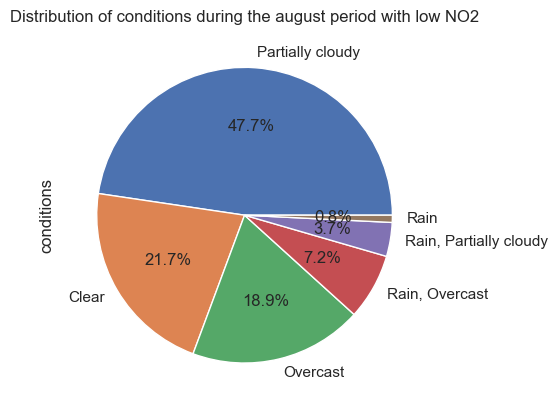

In [98]:
plt.figure()
conditions_low_counts.plot(kind='pie', autopct='%1.1f%%')
plt.title('Distribution of conditions during the august period with low NO2')
plt.xticks(rotation=45)
plt.show()

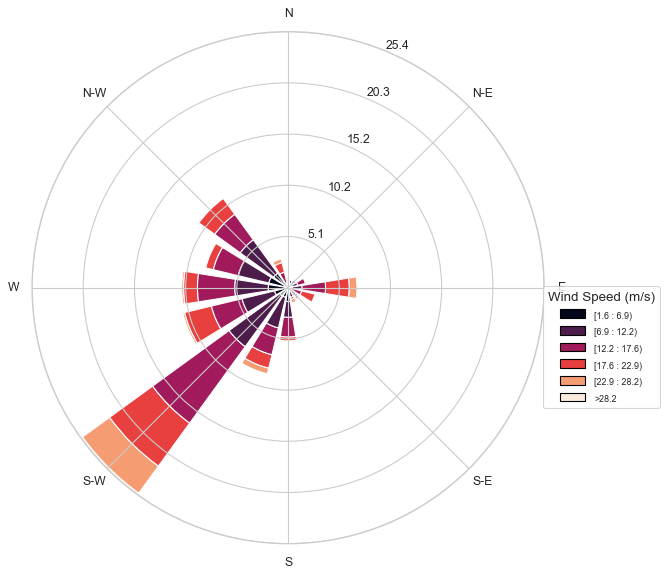

In [99]:
#does windirection affect the rate of pollution?
import matplotlib.pyplot as plt
from windrose import WindroseAxes
import numpy as np
# Create a WindroseAxes
ax = WindroseAxes.from_ax()

ax.bar(Low_pollution['winddir'], Low_pollution['windspeed'], normed=True, opening=0.8, edgecolor='white')

# Customize the wind rose plot
ax.set_legend(title='Wind Speed (m/s)', loc='upper left', bbox_to_anchor=(1, 0.5))

# Show the plot
plt.show()

In [100]:
start_date ='2023-01-15'
end_date = '2023-02-16'

# Select data within the date range
high_pollution= DF_F[(DF_F['Datetime'] >= start_date) & (DF_F['Datetime'] <= end_date)]
high_pollution.reset_index(drop=True, inplace=True)

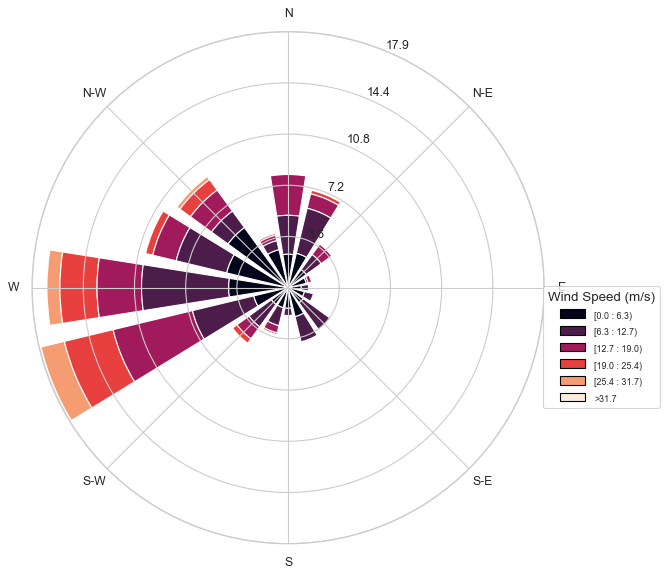

In [101]:
#does windirection affect the rate of pollution?
import matplotlib.pyplot as plt
from windrose import WindroseAxes
import numpy as np
# Create a WindroseAxes
ax = WindroseAxes.from_ax()

ax.bar(high_pollution['winddir'], high_pollution['windspeed'], normed=True, opening=0.8, edgecolor='white')

# Customize the wind rose plot
ax.set_legend(title='Wind Speed (m/s)', loc='upper left', bbox_to_anchor=(1, 0.5))

# Show the plot
plt.show()

In [102]:
DF_F.set_index('Datetime', inplace=True)
df_24hourly = DF_F.resample('24H').mean()

C:\Users\User\AppData\Local\Temp\ipykernel_11448\2030340239.py:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_24hourly = DF_F.resample('24H').mean()


In [103]:
df_24hourly.head(2)

,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,precip,windgust,windspeed,winddir,visibility,NO µg/m3,NO2 µg/m3,NOx µg/m3
Datetime,,,,,,,,,,,,,
2022-11-13,34.247917,38.188333,1011.067083,87.919167,11.882917,0.001250,13.829167,8.554167,115.708333,6.629167,15.88835,21.901042,49.670813
2022-11-14,37.545833,52.727917,1000.385417,89.692083,11.104583,0.031083,14.504167,6.329167,171.250000,4.975000,35.09960,22.734896,70.493953


In [104]:
import plotly.express as px
import pandas as pd

# using df_24hourly DataFrame with datetime index and 'PM10 Scaled µg/m³' column
fig = px.bar(df_24hourly, x=df_24hourly.index, y='PM10 Scaled µg/m³', labels={'PM10 Scaled µg/m³': 'Amount of PM10'},
             title='PM10 Emission Over Time (24-hour mean)',
             template='plotly_white')

fig.update_layout(xaxis_title='Datetime',
                  yaxis_title='Amount of PM10',
                  xaxis_tickangle=-45)

# Add a horizontal line at y=45(WHO 24hour average)
fig.add_shape(type='line', x0=df_24hourly.index.min(), x1=df_24hourly.index.max(), y0=45, y1=45,
              line=dict(color='red', width=3, dash='dash'))

# Show the interactive plot
fig.show()

In [105]:
PM10_above_who_counts = (df_24hourly['PM10 Scaled µg/m³'] > 45).value_counts()

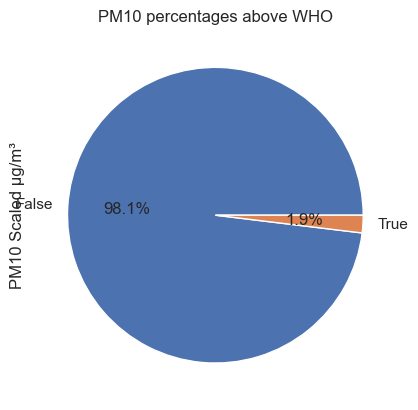

In [106]:
plt.figure()
PM10_above_who_counts.plot(kind='pie', autopct='%1.1f%%')
plt.title('PM10 percentages above WHO')
plt.xticks(rotation=45)
plt.show()

In [107]:
# using df_24hourly DataFrame with datetime index and 'PM10 Scaled µg/m³' column
fig = px.bar(df_24hourly, x=df_24hourly.index, y='PM2.5 Scaled µg/m³', labels={'PM2.5 Scaled µg/m³': 'Amount of PM2.5'},
             title='PM2.5 Emission Over Time (24-hour mean)',
             template='plotly_white')

fig.update_layout(xaxis_title='Datetime',
                  yaxis_title='Amount of PM2.5',
                  xaxis_tickangle=-45)

# Add a horizontal line at y=45(WHO 24hour average)
fig.add_shape(type='line', x0=df_24hourly.index.min(), x1=df_24hourly.index.max(), y0=15, y1=15,
              line=dict(color='red', width=3, dash='dash'))

# Show the interactive plot
fig.show()

In [108]:
PM2_above_who_counts = (df_24hourly['PM2.5 Scaled µg/m³'] > 15).value_counts()

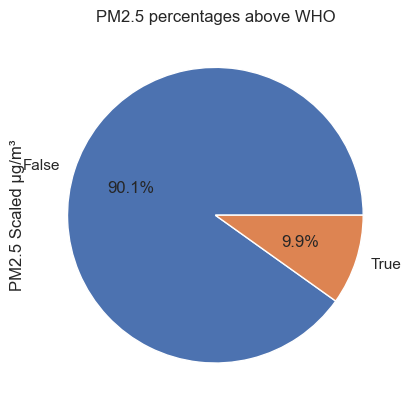

In [109]:
plt.figure()
PM2_above_who_counts.plot(kind='pie', autopct='%1.1f%%')
plt.title('PM2.5 percentages above WHO')
plt.xticks(rotation=45)
plt.show()

In [110]:
# using df_24hourly DataFrame with datetime index and 'PM10 Scaled µg/m³' column
fig = px.bar(df_24hourly, x=df_24hourly.index, y='NO2 µg/m3', labels={'NO2 µg/m3': 'Amount of NO2'},
             title='NO2 Emission Over Time (24-hour mean)',
             template='plotly_white')

fig.update_layout(xaxis_title='Datetime',
                  yaxis_title='Amount of NO2',
                  xaxis_tickangle=-45)

# Add a horizontal line at y=45(WHO 24hour average)
fig.add_shape(type='line', x0=df_24hourly.index.min(), x1=df_24hourly.index.max(), y0=25, y1=25,
              line=dict(color='red', width=3, dash='dash'))

# Show the interactive plot
fig.show()

from the graph PM10 pollution is significantly high

In [111]:
NO2_above_who_counts = (df_24hourly['NO2 µg/m3'] > 25).value_counts()

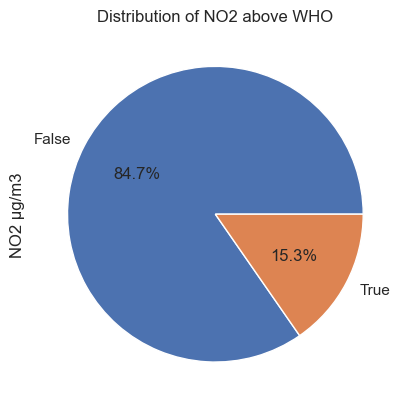

In [112]:
plt.figure()
NO2_above_who_counts.plot(kind='pie', autopct='%1.1f%%')
plt.title('Distribution of NO2 above WHO')
plt.xticks(rotation=45)
plt.show()

In [113]:
DF_F.head(2)

,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,precip,windgust,windspeed,winddir,visibility,conditions,icon,NO µg/m3,NO2 µg/m3,NOx µg/m3
Datetime,,,,,,,,,,,,,,,
2022-11-13 00:00:00,51.21,66.34,1016.00,88.45,11.35,0.019,24.1,8.6,116.0,5.0,"Rain, Overcast",rain,2.4252,24.025,39.225375
2022-11-13 01:00:00,40.59,37.35,1015.43,88.60,11.80,0.000,18.4,9.5,135.0,4.4,Overcast,cloudy,0.4324,18.075,28.094625


In [114]:
unique_conditions = DF_F['conditions'].unique()

In [115]:
print(unique_conditions)

['Rain, Overcast' 'Overcast' 'Partially cloudy' 'Clear' 'Rain' 'Rain, Fog'
 'Rain, Partially cloudy' 'Snow, Rain, Overcast' 'Snow, Rain'
 'Snow, Rain, Partially cloudy']


In [116]:
#since wind direction and wind speed are factors that are correlated we form a product of these factors so as to form a wind vector column
import numpy as np

DF_F['Windvector'] = DF_F['windspeed'] * DF_F['winddir']



In [117]:
DF_F1=DF_F.reset_index()

In [118]:
DF_F1.head(2)

,Datetime,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,precip,windgust,windspeed,winddir,visibility,conditions,icon,NO µg/m3,NO2 µg/m3,NOx µg/m3,Windvector
0,2022-11-13 00:00:00,51.21,66.34,1016.00,88.45,11.35,0.019,24.1,8.6,116.0,5.0,"Rain, Overcast",rain,2.4252,24.025,39.225375,997.6
1,2022-11-13 01:00:00,40.59,37.35,1015.43,88.60,11.80,0.000,18.4,9.5,135.0,4.4,Overcast,cloudy,0.4324,18.075,28.094625,1282.5


In [119]:
#selecting the first part of peak PM2.5 pollution
start_date ='2022-11-29'
end_date = '2022-12-18'

# Select data within the date range
Peak_PM2 = DF_F1[(DF_F1['Datetime'] >= start_date) & (DF_F1['Datetime'] <= end_date)]
Peak_PM2.reset_index(drop=True, inplace=True)

In [120]:
alt.Chart(DF_F1).mark_point().encode(
    x='PM10 Scaled µg/m³',
    y='Temperature C',
).properties(
    width= 400,
    height=200
)

alt.Chart(...)

In [121]:
import altair as alt
chart=alt.Chart(DF_F1).mark_point().encode(
    y='NO2 µg/m3',
    x='Windvector',
).properties(
    width= 400,
    height=200
)
# Add trend line
trendline = chart.transform_regression('Windvector', 'NO2 µg/m3').mark_line(color='red')

# Combine chart and trend line
chart + trendline

alt.LayerChart(...)

The observed relationship is a negative logarithmic relationship as shown in the equation -NO2=a⋅log(Windvector)+b, where a and b are constants.

(array([19174., 19266., 19358., 19448., 19539., 19631., 19723., 19814.]),
 [Text(19174.0, 0, '2022-07'),
  Text(19266.0, 0, '2022-10'),
  Text(19358.0, 0, '2023-01'),
  Text(19448.0, 0, '2023-04'),
  Text(19539.0, 0, '2023-07'),
  Text(19631.0, 0, '2023-10'),
  Text(19723.0, 0, '2024-01'),
  Text(19814.0, 0, '2024-04')])

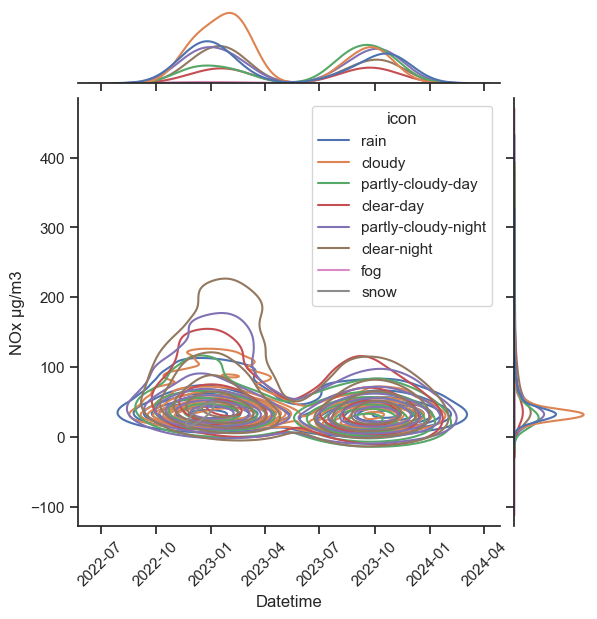

In [122]:
import seaborn as sns
sns.set_theme(style="ticks")


# Show the joint distribution using kernel density estimation
g = sns.jointplot(
    data=DF_F1,
    x="Datetime", y="NOx µg/m3", hue="icon",
    kind="kde",
)
plt.xticks(rotation=45)

In [123]:
DF_F1.head(2)

,Datetime,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,precip,windgust,windspeed,winddir,visibility,conditions,icon,NO µg/m3,NO2 µg/m3,NOx µg/m3,Windvector
0,2022-11-13 00:00:00,51.21,66.34,1016.00,88.45,11.35,0.019,24.1,8.6,116.0,5.0,"Rain, Overcast",rain,2.4252,24.025,39.225375,997.6
1,2022-11-13 01:00:00,40.59,37.35,1015.43,88.60,11.80,0.000,18.4,9.5,135.0,4.4,Overcast,cloudy,0.4324,18.075,28.094625,1282.5


In [124]:
start_date ='2022-11-29'
end_date = '2022-12-18'

# Select data within the date range
Peak_PM2 = DF_F1[(DF_F1['Datetime'] >= start_date) & (DF_F1['Datetime'] <= end_date)]
Peak_PM2.reset_index(drop=True, inplace=True)

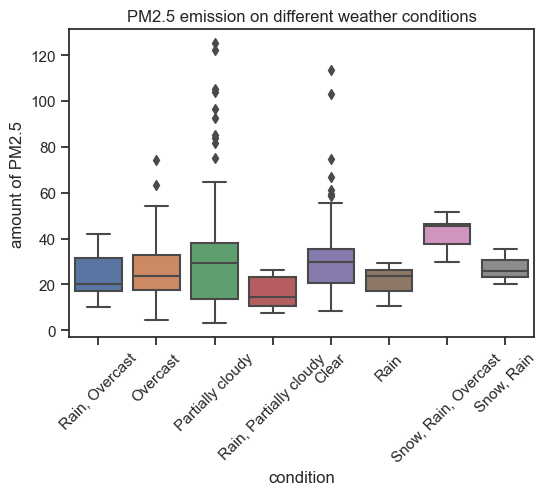

In [125]:
plt.figure(figsize=(6, 4))
sns.boxplot(x='conditions', y='PM2.5 Scaled µg/m³', data=Peak_PM2)
plt.title('PM2.5 emission on different weather conditions')
plt.xlabel('condition')
plt.ylabel('amount of PM2.5')
plt.xticks(rotation=45)
plt.show()

In [126]:
Peak_PM2_count = Peak_PM2[Peak_PM2['PM2.5 Scaled µg/m³'] > 0]['conditions'].value_counts()


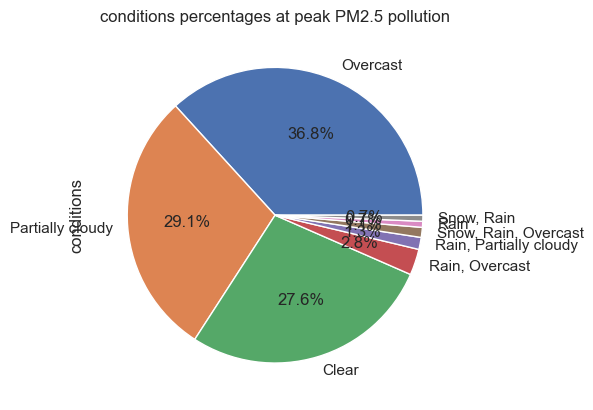

In [127]:
plt.figure()
Peak_PM2_count.plot(kind='pie', autopct='%1.1f%%')
plt.title('conditions percentages at peak PM2.5 pollution')
plt.xticks(rotation=45)
plt.show()

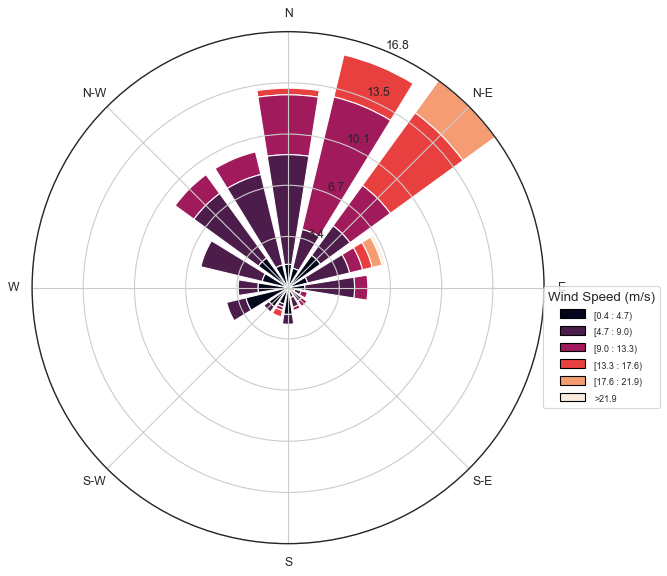

In [128]:
#does windirection affect the rate of PM2.5 at Peak pollution?
import matplotlib.pyplot as plt
from windrose import WindroseAxes
import numpy as np
# Create a WindroseAxes
ax = WindroseAxes.from_ax()

ax.bar(Peak_PM2['winddir'], Peak_PM2['windspeed'], normed=True, opening=0.8, edgecolor='white')

# Customize the wind rose plot
ax.set_legend(title='Wind Speed (m/s)', loc='upper left', bbox_to_anchor=(1, 0.5))

# Show the plot
plt.show()

In [129]:
start_date ='2022-12-19'
end_date = '2023-01-15'

# Select data within the date range
low_PM2 = DF_F1[(DF_F1['Datetime'] >= start_date) & (DF_F1['Datetime'] <= end_date)]
low_PM2.reset_index(drop=True, inplace=True)

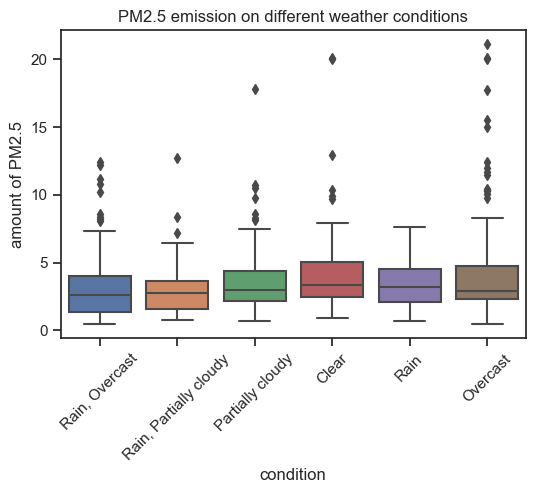

In [130]:
plt.figure(figsize=(6, 4))
sns.boxplot(x='conditions', y='PM2.5 Scaled µg/m³', data=low_PM2)
plt.title('PM2.5 emission on different weather conditions')
plt.xlabel('condition')
plt.ylabel('amount of PM2.5')
plt.xticks(rotation=45)
plt.show()

In [131]:
low_PM2_count = low_PM2[low_PM2['PM2.5 Scaled µg/m³'] > 0]['conditions'].value_counts()

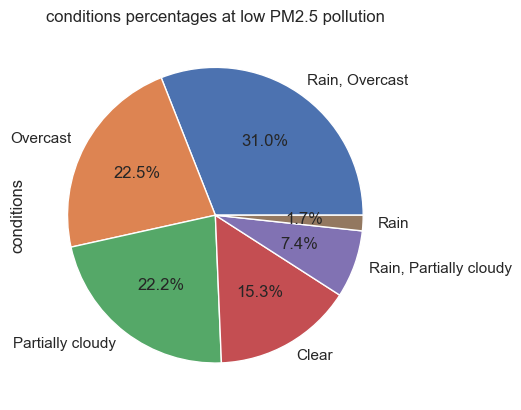

In [132]:
plt.figure()
low_PM2_count.plot(kind='pie', autopct='%1.1f%%')
plt.title('conditions percentages at low PM2.5 pollution')
plt.xticks(rotation=45)
plt.show()

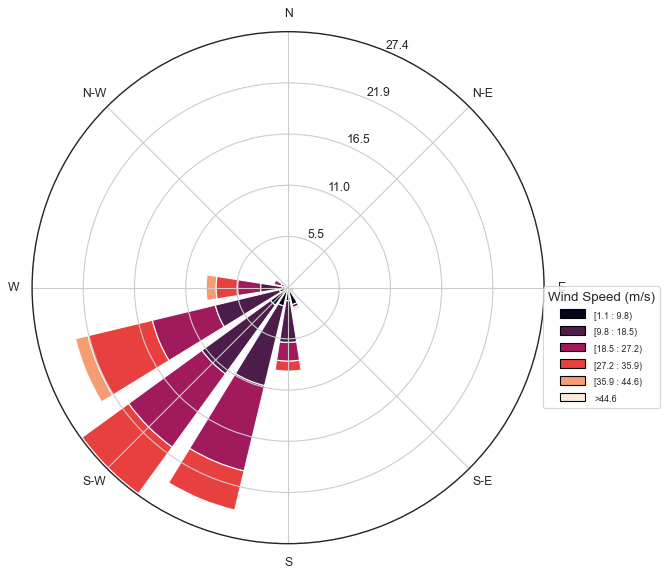

In [133]:
#does windirection affect the rate of PM2.5 at low pollution?
import matplotlib.pyplot as plt
from windrose import WindroseAxes
import numpy as np
# Create a WindroseAxes
ax = WindroseAxes.from_ax()

ax.bar(low_PM2['winddir'], low_PM2['windspeed'], normed=True, opening=0.8, edgecolor='white')

# Customize the wind rose plot
ax.set_legend(title='Wind Speed (m/s)', loc='upper left', bbox_to_anchor=(1, 0.5))

# Show the plot
plt.show()

In [134]:
#selecting the first part of peak PM2.5 pollution
start_date ='2023-02-06'
end_date = '2023-02-15'

# Select data within the date range
Peak_PM10 = DF_F1[(DF_F1['Datetime'] >= start_date) & (DF_F1['Datetime'] <= end_date)]
Peak_PM10.reset_index(drop=True, inplace=True)

In [135]:
Peak_PM10_count = DF_F1[DF_F1['PM10 Scaled µg/m³'] > 45]['conditions'].value_counts()


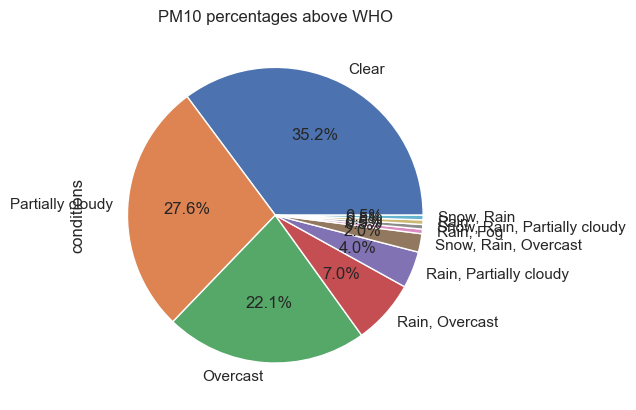

In [136]:
plt.figure()
Peak_PM10_count.plot(kind='pie', autopct='%1.1f%%')
plt.title('PM10 percentages above WHO')
plt.xticks(rotation=45)
plt.show()

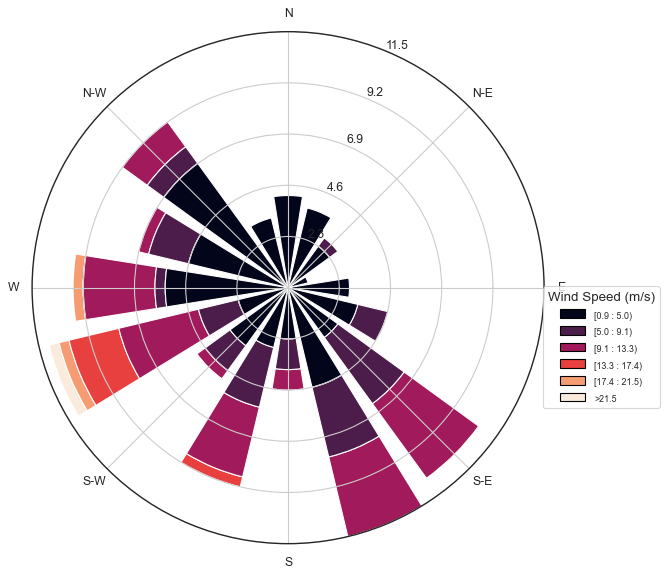

In [137]:
#does windirection affect the rate of pollution?
import matplotlib.pyplot as plt
from windrose import WindroseAxes
import numpy as np
# Create a WindroseAxes
ax = WindroseAxes.from_ax()

ax.bar(Peak_PM10['winddir'], Peak_PM10['windspeed'], normed=True, opening=0.8, edgecolor='white')

# Customize the wind rose plot
ax.set_legend(title='Wind Speed (m/s)', loc='upper left', bbox_to_anchor=(1, 0.5))

# Show the plot
plt.show()

In [138]:
start_date ='2022-12-24'
end_date = '2023-01-17'

# Select data within the date range
Low_PM10= DF_F1[(DF_F1['Datetime'] >= start_date) & (DF_F1['Datetime'] <= end_date)]
Low_PM10.reset_index(drop=True, inplace=True)

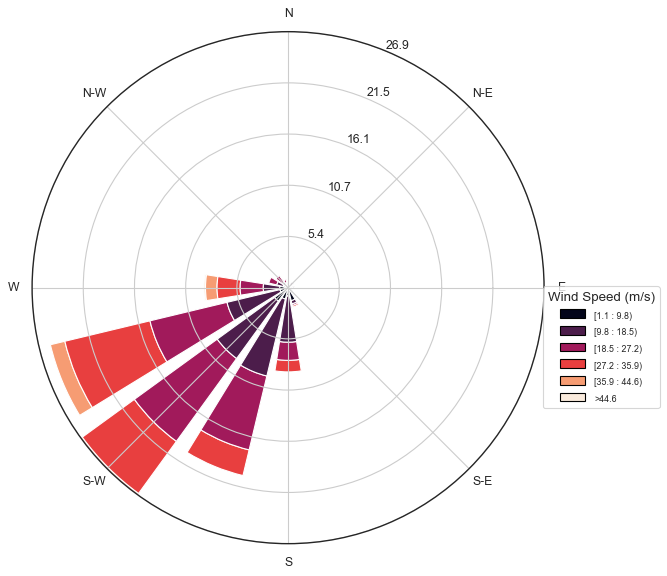

In [139]:
#does windirection affect the rate of PM10 at low pollution
import matplotlib.pyplot as plt
from windrose import WindroseAxes
import numpy as np
# Create a WindroseAxes
ax = WindroseAxes.from_ax()

ax.bar(Low_PM10['winddir'], Low_PM10['windspeed'], normed=True, opening=0.8, edgecolor='white')

# Customize the wind rose plot
ax.set_legend(title='Wind Speed (m/s)', loc='upper left', bbox_to_anchor=(1, 0.5))

# Show the plot
plt.show()

In [140]:
import altair as alt
alt.Chart(DF_F1).mark_point().encode(
    x='PM10 Scaled µg/m³',
    y='Windvector',
).properties(
    width= 400,
    height=200
)

alt.Chart(...)

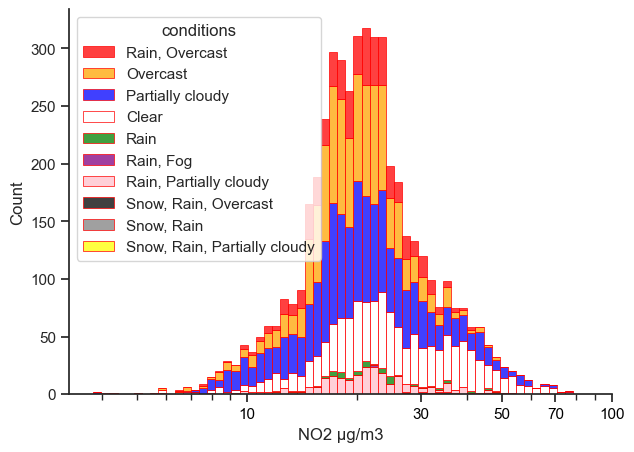

In [141]:
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt


# Define your custom color palette
custom_palette = ["red", "orange", "blue", "white", "green", "purple", "pink", "black", "grey", "yellow"]

sns.set_theme(style="ticks")

f, ax = plt.subplots(figsize=(7, 5))
sns.despine(f)

sns.histplot(
    DF_F1,
    x="NO2 µg/m3", hue="conditions",
    multiple="stack",
    palette=sns.color_palette(custom_palette),
    edgecolor="red",
    linewidth=0.5,
    log_scale=True,
)

# Set x-axis ticks and labels
ax.xaxis.set_major_formatter(mpl.ticker.ScalarFormatter())
ax.set_xticks([10, 30, 50, 70, 100])
ax.set_xticklabels(["10", "30", "50", "70", "100"], color='black')  

plt.show()



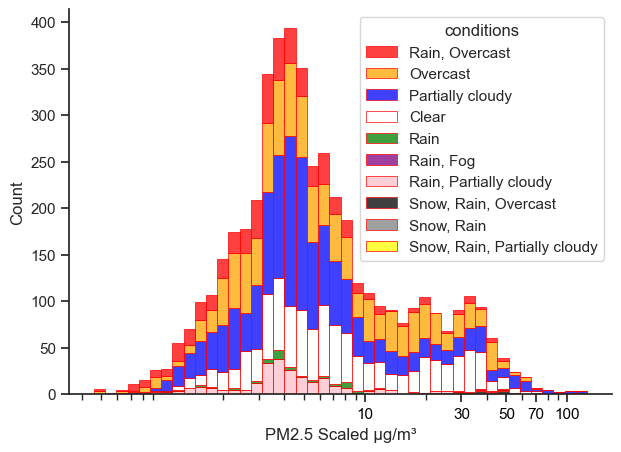

In [142]:
# Define your custom color palette
custom_palette = ["red", "orange", "blue", "white", "green", "purple", "pink", "black", "grey", "yellow"]

sns.set_theme(style="ticks")

f, ax = plt.subplots(figsize=(7, 5))
sns.despine(f)

sns.histplot(
    DF_F1,
    x="PM2.5 Scaled µg/m³", hue="conditions",
    multiple="stack",
    palette=sns.color_palette(custom_palette),
    edgecolor="red",
    linewidth=0.5,
    log_scale=True,
)

# Set x-axis ticks and labels
ax.xaxis.set_major_formatter(mpl.ticker.ScalarFormatter())
ax.set_xticks([10, 30, 50, 70, 100])
ax.set_xticklabels(["10", "30", "50", "70", "100"], color='black')  

plt.show()

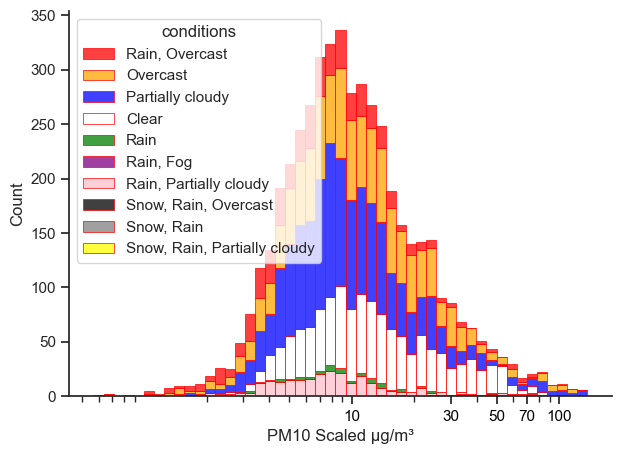

In [143]:
# Define your custom color palette
custom_palette = ["red", "orange", "blue", "white", "green", "purple", "pink", "black", "grey", "yellow"]

sns.set_theme(style="ticks")

f, ax = plt.subplots(figsize=(7, 5))
sns.despine(f)

sns.histplot(
    DF_F1,
    x="PM10 Scaled µg/m³", hue="conditions",
    multiple="stack",
    palette=sns.color_palette(custom_palette),
    edgecolor="red",
    linewidth=0.5,
    log_scale=True,
)

# Set x-axis ticks and labels
ax.xaxis.set_major_formatter(mpl.ticker.ScalarFormatter())
ax.set_xticks([10, 30, 50, 70, 100])
ax.set_xticklabels(["10", "30", "50", "70", "100"], color='black')  

plt.show()

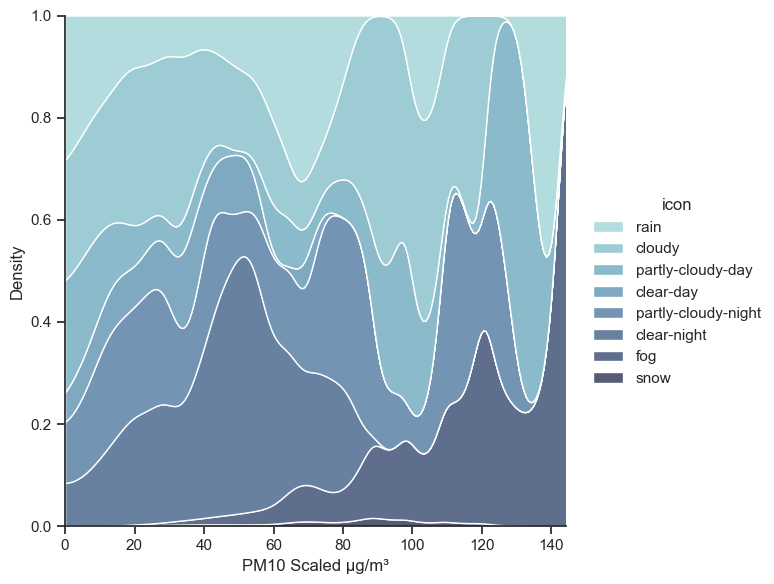

In [144]:
# Plot the distribution of PM10, conditional on Weather contions
sns.displot(
    data=DF_F1,
    x="PM10 Scaled µg/m³", hue="icon",
    kind="kde", height=6,
    multiple="fill", clip=(0, None),
    palette="ch:rot=-.25,hue=1,light=.75",
)

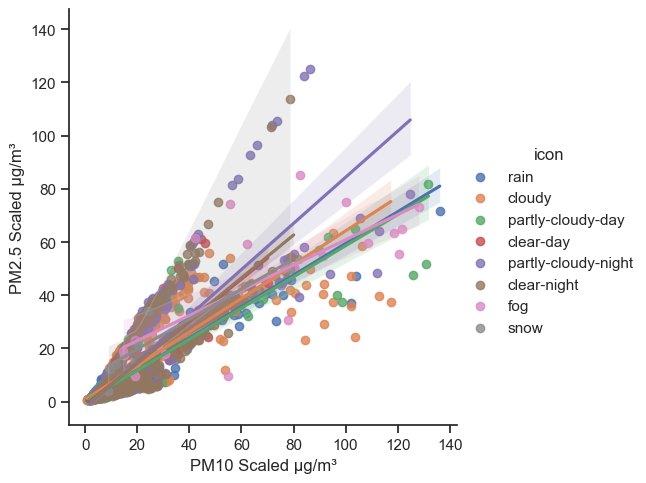

In [145]:
# PM10 against PM2.5 with conditions
g = sns.lmplot(
    data=DF_F1,
    x="PM10 Scaled µg/m³", y="PM2.5 Scaled µg/m³", hue="icon",
    height=5
)

In [146]:
DF_F1.head(1)

,Datetime,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,precip,windgust,windspeed,winddir,visibility,conditions,icon,NO µg/m3,NO2 µg/m3,NOx µg/m3,Windvector
0,2022-11-13,51.21,66.34,1016.0,88.45,11.35,0.019,24.1,8.6,116.0,5.0,"Rain, Overcast",rain,2.4252,24.025,39.225375,997.6


In [147]:
# Define bin edges and labels
bin_edges = [-float('inf'), 67, 134, 200, 267, 334, 400, 467, 534, 600, float('inf')]  
bin_labels = ['Low1', 'Low2', 'Low3', 'moderate4', 'moderate5', 'moderate6', 'High7', 'high8', 'High9', 'High10']

# Creating a new column 'NO2 Category' based on binning
DF_F1['NO2 Category'] = pd.cut(DF_F1['NO2 µg/m3'], bins=bin_edges, labels=bin_labels, include_lowest=True)




In [148]:
DF_F1.head(2)

,Datetime,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,precip,windgust,windspeed,winddir,visibility,conditions,icon,NO µg/m3,NO2 µg/m3,NOx µg/m3,Windvector,NO2 Category
0,2022-11-13 00:00:00,51.21,66.34,1016.00,88.45,11.35,0.019,24.1,8.6,116.0,5.0,"Rain, Overcast",rain,2.4252,24.025,39.225375,997.6,Low1
1,2022-11-13 01:00:00,40.59,37.35,1015.43,88.60,11.80,0.000,18.4,9.5,135.0,4.4,Overcast,cloudy,0.4324,18.075,28.094625,1282.5,Low1


In [149]:
# Define bin edges and labels
bin_edges = [-float('inf'), 11, 23, 35, 41, 47, 53, 58, 64, 70, float('inf')]  
bin_labels = ['Low1', 'Low2', 'Low3', 'moderate4', 'moderate5', 'moderate6', 'High7', 'high8', 'High9', 'High10']

# Creating a new column 'PM2.5 Category' based on binning
DF_F1['PM2.5 Category'] = pd.cut(DF_F1['PM2.5 Scaled µg/m³'], bins=bin_edges, labels=bin_labels, include_lowest=True)

In [150]:
# Define bin edges and labels
bin_edges = [-float('inf'), 16, 33, 50, 58, 66, 75, 83, 91, 100, float('inf')]  
bin_labels = ['Low1', 'Low2', 'Low3', 'moderate4', 'moderate5', 'moderate6', 'High7', 'high8', 'High9', 'High10']

# Creating a new column 'PM10 Category' based on binning
DF_F1['PM10 Category'] = pd.cut(DF_F1['PM10 Scaled µg/m³'], bins=bin_edges, labels=bin_labels, include_lowest=True)

In [151]:
DF_F2=DF_F1.drop(['NOx µg/m3', 'NO µg/m3'], axis=1)
DF_F2.reset_index(drop=True, inplace=True)

In [152]:
DF_F2.head(2)

,Datetime,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,precip,windgust,windspeed,winddir,visibility,conditions,icon,NO2 µg/m3,Windvector,NO2 Category,PM2.5 Category,PM10 Category
0,2022-11-13 00:00:00,51.21,66.34,1016.00,88.45,11.35,0.019,24.1,8.6,116.0,5.0,"Rain, Overcast",rain,24.025,997.6,Low1,moderate6,moderate6
1,2022-11-13 01:00:00,40.59,37.35,1015.43,88.60,11.80,0.000,18.4,9.5,135.0,4.4,Overcast,cloudy,18.075,1282.5,Low1,moderate4,Low3


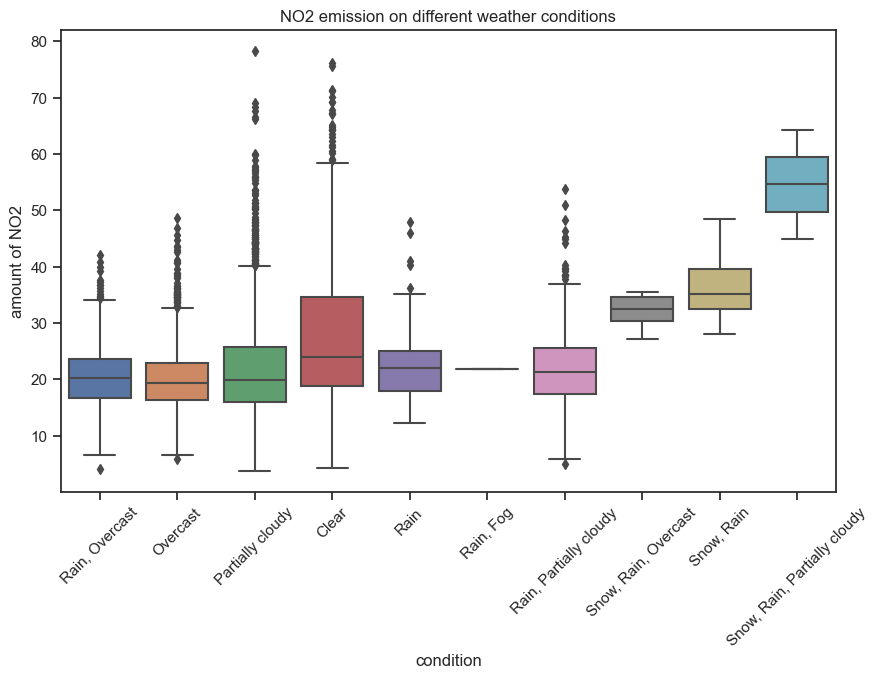

In [153]:
#creating boxplots to compare NOX emission across different weather conditions
plt.figure(figsize=(10, 6))
sns.boxplot(x='conditions', y='NO2 µg/m3', data=DF_F1)
plt.title('NO2 emission on different weather conditions')
plt.xlabel('condition')
plt.ylabel('amount of NO2')
plt.xticks(rotation=45)
plt.show()

from the plots, cloudy condition has the largest data dispersion. 50% of the data in cloudy condition is under 27ppb, on the rain condition under 33ppb, in partly cloudy day under 35ppb, on clear-day, partly-cloudy-night, and clear night is under 30ppb while on a fogy day the Nox volume 100% of the data is under 14ppb. from the boxplot the gas volumes of NOX measured in rain, and partly-cloudy conditions have the highest NOX volume measurements, while fogy conditions have the lowest measurements. in general rain and partly-cloudy conditions are prime for peak NOX volume measurements.

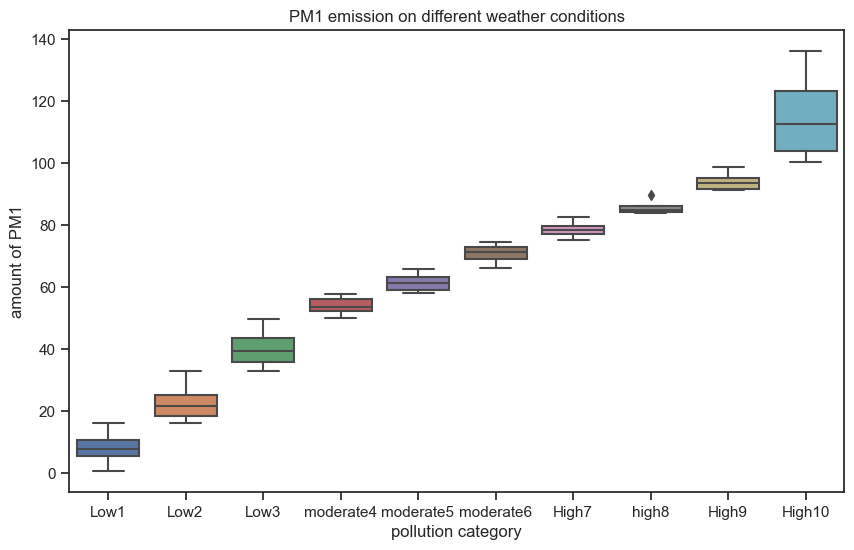

In [154]:
#creating boxplots to compare PM1 emission across different weather conditions
plt.figure(figsize=(10, 6))
sns.boxplot(x='PM10 Category', y='PM10 Scaled µg/m³', data=DF_F2)
plt.title('PM1 emission on different weather conditions')
plt.xlabel('pollution category')
plt.ylabel('amount of PM1')
plt.show()

The dispersion in cloudy condition is high. 50% of the PM1 volume measurements are below 5.8% of total pollutants. and lowest on partly-cloudy, and clear-day conditions. in fogy conditions 100% of PM1 volume measurements are 14% and below of Total pollutants.

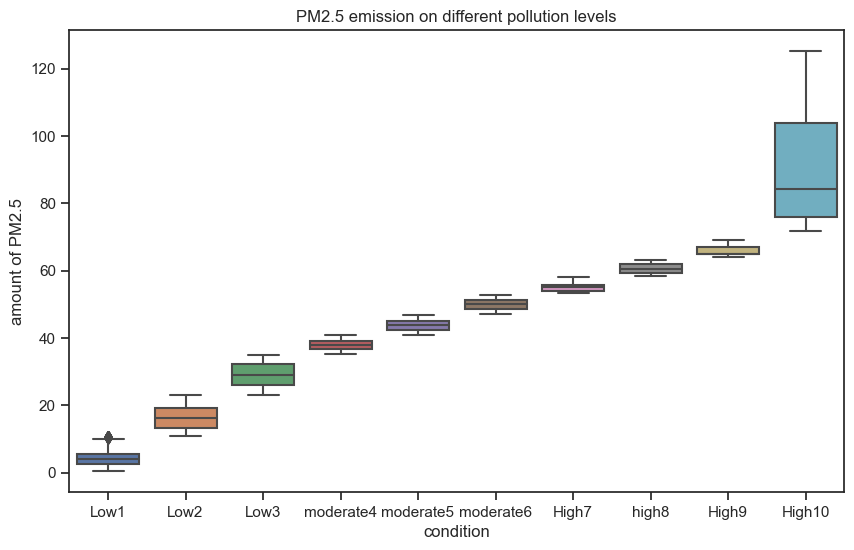

In [155]:
#creating boxplots to compare PM2.5 emission across different weather conditions
plt.figure(figsize=(10, 6))
sns.boxplot(x='PM2.5 Category', y='PM2.5 Scaled µg/m³', data=DF_F2)
plt.title('PM2.5 emission on different pollution levels')
plt.xlabel('condition')
plt.ylabel('amount of PM2.5')
plt.show()

in cloudy conditions data disperstion is largest. the highest volume measurements are within this period. in cloudy conditions 50% of PM2.5 volumes measured are below 10% of total pollutants volumes. the lowest volumes measured being on rain and partly-cloudy conditions. in fogy conditions 100% of PM2.5 values are above 20% by volume of the total pollutants. under the provided conditions fogy conditions prove to be more prime for PM2.5 emission/formation followed by Cloudy conditions.

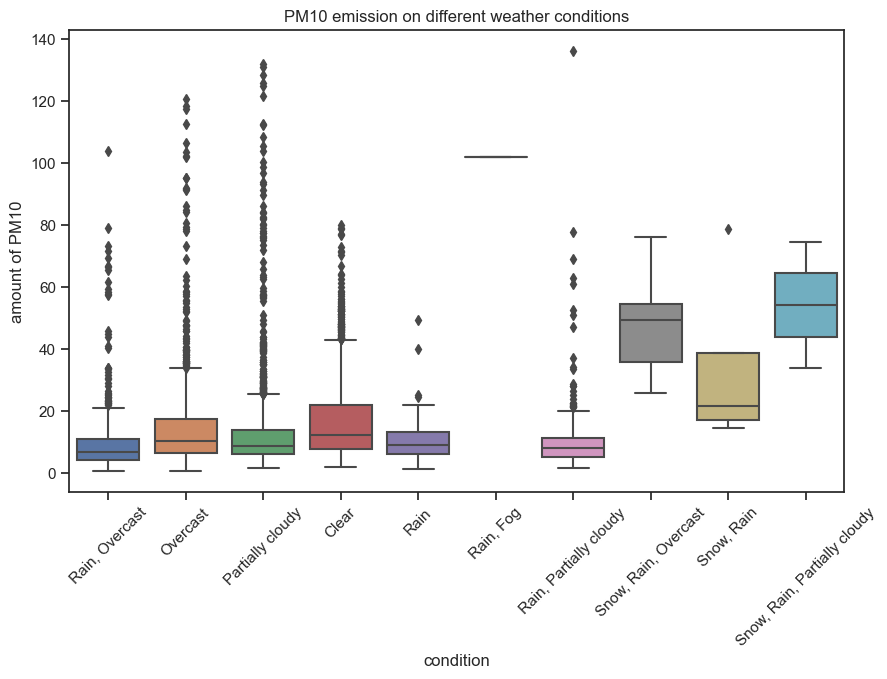

In [156]:
#creating boxplots to compare PM4 emission across different weather conditions
plt.figure(figsize=(10, 6))
sns.boxplot(x='conditions', y='PM10 Scaled µg/m³', data=DF_F2)
plt.title('PM10 emission on different weather conditions')
plt.xlabel('condition')
plt.ylabel('amount of PM10')
plt.xticks(rotation=45)
plt.show()

in PM10 50% of the measured values are highest in cloudy, clear-day, clear-night and fogy conditions. the values range beteen 13-16.8% of total pollutants volumes.

In [157]:
import altair as alt
Chart1= alt.Chart(DF_F2).mark_bar().encode(
    x='Datetime:T', 
    y='PM10 Scaled µg/m³:Q', 
    color='PM10 Category:N'
).properties(
    width=300,
    height=300
)

chart2=alt.Chart(DF_F2).mark_bar().encode(
    x='count()',
    y=alt.Y('Temperature C:Q', bin=alt.Bin(maxbins=30)),
    color='PM10 Category:N'
).properties(
    width=300,
    height=300
)

Chart1 | chart2

alt.HConcatChart(...)

In [158]:
import altair as alt
Chart1= alt.Chart(DF_F2).mark_bar().encode(
    x='Datetime:T', 
    y='PM2.5 Scaled µg/m³:Q', 
    color='PM10 Category:N'
).properties(
    width=300,
    height=300
)

chart2=alt.Chart(DF_F2).mark_bar().encode(
    x='count()',
    y=alt.Y('Temperature C:Q', bin=alt.Bin(maxbins=30)),
    color='PM10 Category:N'
).properties(
    width=300,
    height=300
)

Chart1 | chart2

alt.HConcatChart(...)

In [159]:
Monthly_average = DF_F1.groupby(DF_F1['Datetime'].dt.to_period('M')).mean()

C:\Users\User\AppData\Local\Temp\ipykernel_11448\4240930780.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [160]:
 
start_date ='2022-12-31'
end_date = '2023-02-28'

# Select data within the date range
Winter = DF_F2[(DF_F2['Datetime'] >= start_date) & (DF_F2['Datetime'] <= end_date)]
Winter.reset_index(drop=True, inplace=True)

In [161]:
brush = alt.selection_interval()

In [162]:
alt.Chart(Winter).mark_point().encode(
    x='Datetime:T',
    y='mean(PM10 Scaled µg/m³):Q',
    color=alt.condition(brush, 'PM10 Category:O', alt.value('lightgray')),
    shape='conditions:N'
).transform_filter(
    alt.FieldOneOfPredicate(
        field='PM10 Category',
        oneOf=['Low1', 'Low2', 'Low3', 'moderate4', 'moderate5', 'moderate6', 'High7', 'high8', 'High9', 'High10']
    )
).add_selection(
    brush
)

C:\Users\User\AppData\Roaming\Python\Python310\site-packages\altair\utils\deprecation.py:65: AltairDeprecationWarning:

'add_selection' is deprecated. Use 'add_params' instead.



alt.Chart(...)

the selected period above has specifically high PM10 pollution, the period between feb 12 and 19 feb have the highest percentage of very low, low and medium PM10 pollution, followed by the periods between 15th and 29th of Janury. on the selected period, the period between 19th and 26th february has the lowest measured, very low, low and medium pollution frequencies as seen above, at overcast, partially cloudy, rain, partially cloudy conditions, the amount of PM10 pollution is high, with the highest pollution occuring during rain, partially cloudy conditions as seen above.

In [163]:
alt.Chart(Winter).mark_point().encode(
    x='Datetime:T',
    y='mean(Temperature C):Q',
    color=alt.condition(brush, 'NO2 Category', alt.value('lightgray')),
    shape='conditions:N'
).transform_filter(
    alt.FieldOneOfPredicate(
        field='NO2 Category',
        oneOf=['Low1', 'Low2', 'Low3', 'moderate4', 'moderate5', 'moderate6', 'High7', 'high8', 'High9', 'High10']
    )
).add_params(
    brush
)

alt.Chart(...)

There is a high rate of NO2 pollution between January 15th and 19th February as seen in the figure above. the days with the highest NO2 pollution have partially cloudy and clear day as the prevailing conditions. clear conditons periods have the highest NO2 pollution as seen from the figure. in summation NO2 pollution is positively correlated to partially cloudy and clear conditions.

In [164]:
alt.Chart(Winter).mark_point().encode(
    x='Datetime:T',
    y='mean(NO2 µg/m3):Q',
    color=alt.condition(brush, 'NO2 Category:O', alt.value('lightgray')),
    shape='conditions:N'
).transform_filter(
    alt.FieldOneOfPredicate(
        field='NO2 Category',
        oneOf=['Low1', 'Low2', 'Low3', 'moderate4', 'moderate5', 'moderate6', 'High7', 'high8', 'High9', 'High10']
    )
).add_selection(
    brush
)

alt.Chart(...)

In [165]:
alt.Chart(Winter).mark_point().encode(
    x='Datetime:T',
    y='mean(NO2 µg/m3):Q',
    color=alt.condition(brush, 'NO2 Category:O', alt.value('lightgray')),
    shape='conditions:N'
).transform_filter(
    alt.FieldOneOfPredicate(
        field='NO2 Category',
        oneOf=['Low1', 'Low2', 'Low3', 'moderate4', 'moderate5', 'moderate6', 'High7', 'high8', 'High9', 'High10']
    )
).add_selection(
    brush
)

alt.Chart(...)

In [166]:
alt.Chart(Winter).mark_point().encode(
    x='Datetime:T',
    y='mean(PM10 Scaled µg/m³):Q',
    color=alt.condition(brush, 'PM10 Category:O', alt.value('lightgray')),
    shape='conditions:N'
).transform_filter(
    alt.FieldOneOfPredicate(
        field='PM10 Category',
        oneOf=['Low1', 'Low2', 'Low3', 'moderate4', 'moderate5', 'moderate6', 'High7', 'high8', 'High9', 'High10']
    )
).add_selection(
    brush
)

alt.Chart(...)

In [167]:
Chart1=alt.Chart(Winter).mark_point().encode(
    x='Datetime:T',
    y='mean(NO2 µg/m3):Q',
    color=alt.condition(brush, 'NO2 Category:O', alt.value('lightgray')),
    shape='conditions:N'
).transform_filter(
    alt.FieldOneOfPredicate(
        field='NO2 Category',
        oneOf=['Low1', 'Low2', 'Low3', 'moderate4', 'moderate5', 'moderate6', 'High7', 'high8', 'High9', 'High10']
    )
).add_params(
    brush
).interactive()
chart2=alt.Chart(Winter).mark_bar().encode(
    x='count()',
    y=alt.Y('Temperature C:Q', bin=alt.Bin(maxbins=30)),
    color='PM10 Category:N'
).properties(
    width=300,
    height=300
).interactive()

Chart1 | chart2

alt.HConcatChart(...)

In [168]:
import altair as alt

# taking'conditions' since it is a column in our filtered_NO2 DataFrame
condition_percentages = Winter['icon'].value_counts(normalize=True).reset_index()

Chart1 = alt.Chart(Winter).mark_point().encode(
    x='Datetime:T',
    y='mean(NO2 µg/m3):Q',
    color=alt.condition(brush, 'NO2 Category:O', alt.value('lightgray')),
    shape='icon:N',
    tooltip=['icon:N']
).transform_filter(
    alt.FieldOneOfPredicate(
        field='NO2 Category',
        oneOf=['Low1', 'Low2', 'Low3', 'moderate4', 'moderate5', 'moderate6', 'High7', 'high8', 'High9', 'High10']
    )
).add_params(
    brush
).interactive()

chart2 = alt.Chart(condition_percentages).mark_bar().encode(
    x='index:N',
    y='icon:Q',
    tooltip=['icon:Q'],
    color=alt.value('blue') 
).properties(
    width=300,
    height=300
).interactive()

Chart1 | chart2


alt.HConcatChart(...)

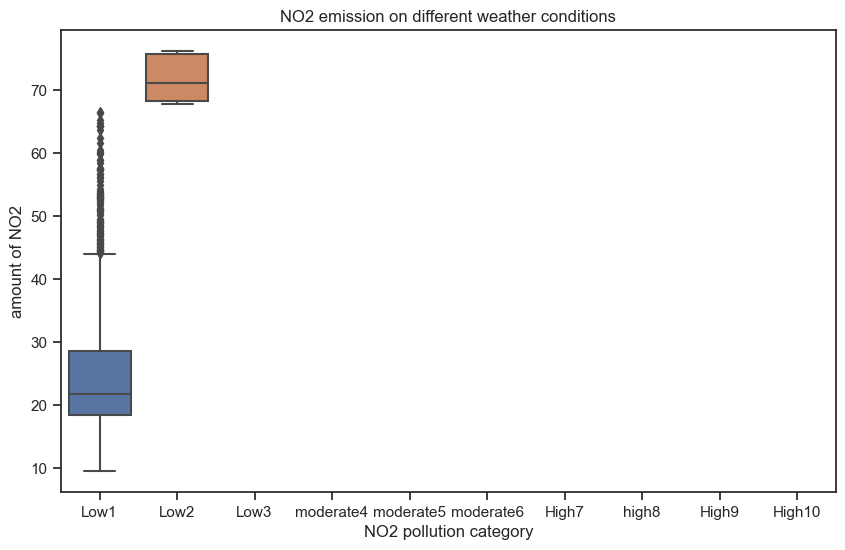

In [169]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='NO2 Category', y='NO2 µg/m3', data=Winter)
plt.title('NO2 emission on different weather conditions')
plt.xlabel('NO2 pollution category')
plt.ylabel('amount of NO2')
plt.show()

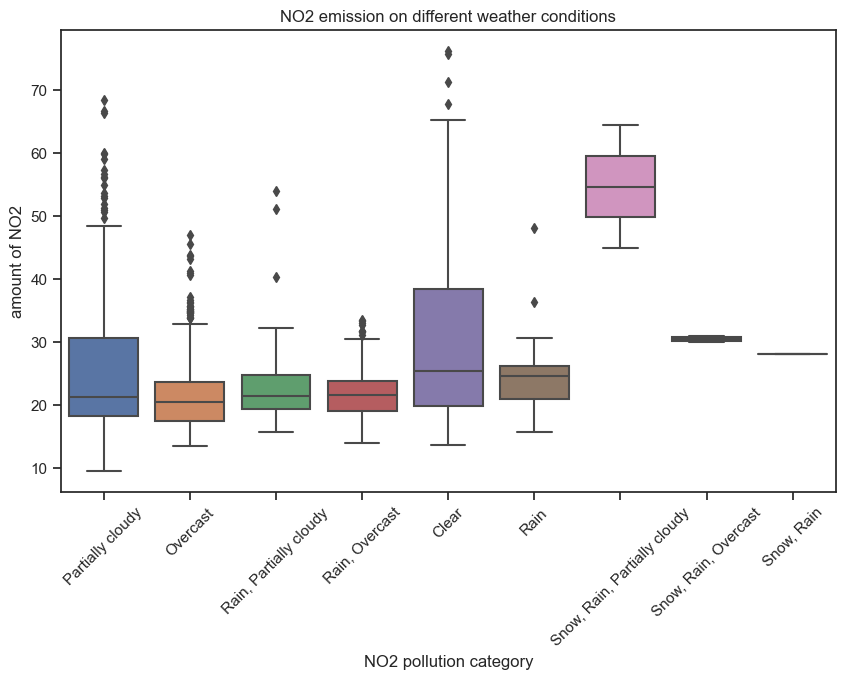

In [170]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='conditions', y='NO2 µg/m3', data=Winter)
plt.title('NO2 emission on different weather conditions')
plt.xlabel('NO2 pollution category')
plt.ylabel('amount of NO2')
plt.xticks(rotation=45)
plt.show()

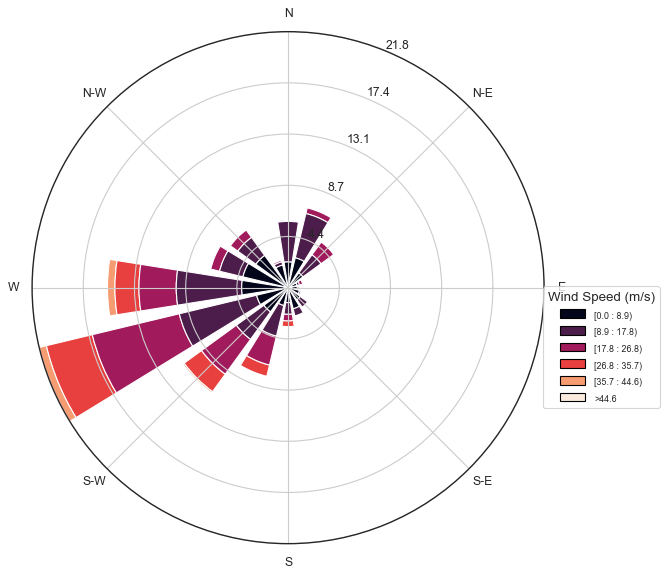

In [171]:
#does windirection affect the rate of pollution?
import matplotlib.pyplot as plt
from windrose import WindroseAxes
import numpy as np
# Create a WindroseAxes
ax = WindroseAxes.from_ax()

ax.bar(Winter['winddir'], Winter['windspeed'], normed=True, opening=0.8, edgecolor='white')

# Customize the wind rose plot
ax.set_legend(title='Wind Speed (m/s)', loc='upper left', bbox_to_anchor=(1, 0.5))

# Show the plot
plt.show()

In [172]:
pollution_category_counts = Winter['NO2 Category'].value_counts()


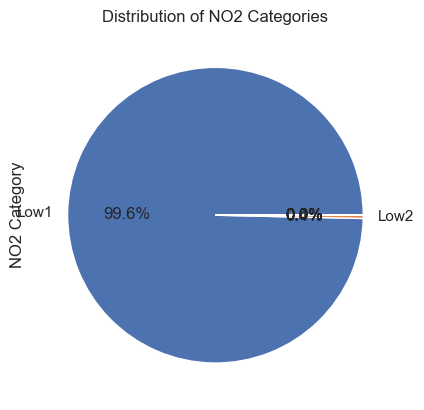

In [173]:
plt.figure()
pollution_category_counts.plot(kind='pie', autopct='%1.1f%%')
plt.title('Distribution of NO2 Categories')
plt.xticks(rotation=45)
plt.show()

In [174]:
pollution_PM10_category_counts = Winter['PM10 Category'].value_counts()

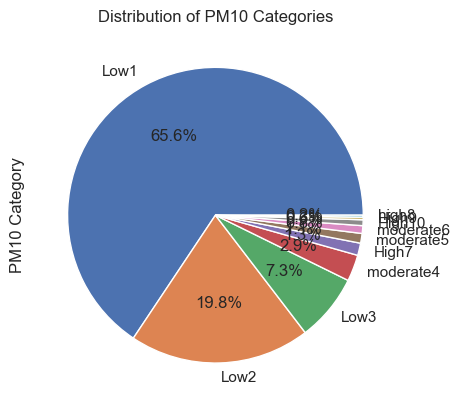

In [175]:
plt.figure()
pollution_PM10_category_counts.plot(kind='pie', autopct='%1.1f%%')
plt.title('Distribution of PM10 Categories')
plt.show()


In [176]:
pollution_PM2_category_counts = Winter['PM2.5 Category'].value_counts()

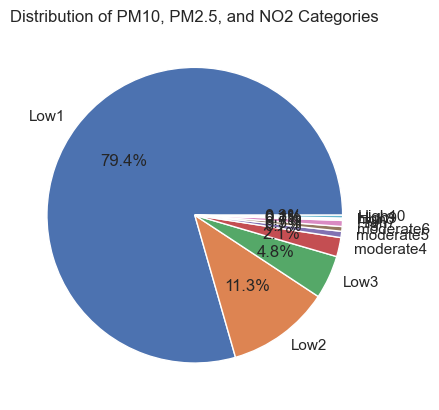

In [177]:
combined_counts = pollution_category_counts.add(pollution_PM2_category_counts, fill_value=0).add(pollution_PM10_category_counts, fill_value=0)
plt.figure()
combined_counts.plot(kind='pie', autopct='%1.1f%%')
plt.title('Distribution of PM10, PM2.5, and NO2 Categories')
plt.show()

C:\Users\User\AppData\Local\Temp\ipykernel_11448\1982126522.py:3: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



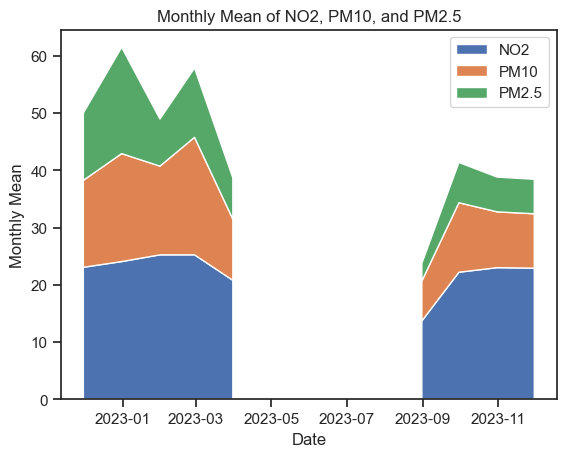

In [178]:
# Resample data to monthly mean
DF_F2.set_index('Datetime', inplace=True)
df_monthly = DF_F2.resample('M').mean()

# Stacked plot
plt.stackplot(df_monthly.index, df_monthly['NO2 µg/m3'], df_monthly['PM10 Scaled µg/m³'], df_monthly['PM2.5 Scaled µg/m³'],
              labels=['NO2', 'PM10', 'PM2.5'])

# Plot customization
plt.xlabel('Date')
plt.ylabel('Monthly Mean')
plt.title('Monthly Mean of NO2, PM10, and PM2.5')
plt.legend(loc='upper right')

# Show the plot
plt.show()
#PM2.5 Scaled µg/m³	PM10 Scaled µg/m³

<Figure size 640x480 with 0 Axes>

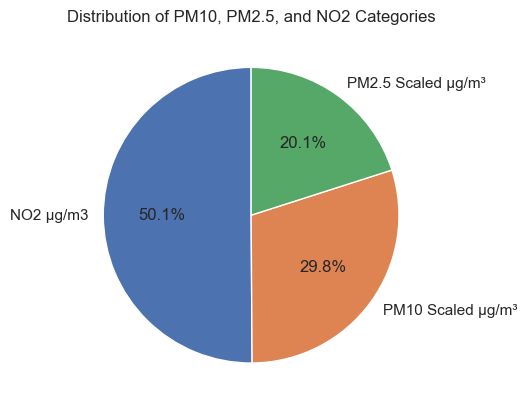

In [179]:

plt.figure()
category_sum = df_monthly[['NO2 µg/m3', 'PM10 Scaled µg/m³', 'PM2.5 Scaled µg/m³']].sum(axis=0)

# Plotting a pie chart
plt.figure()
plt.pie(category_sum, labels=category_sum.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribution of PM10, PM2.5, and NO2 Categories')
plt.show()

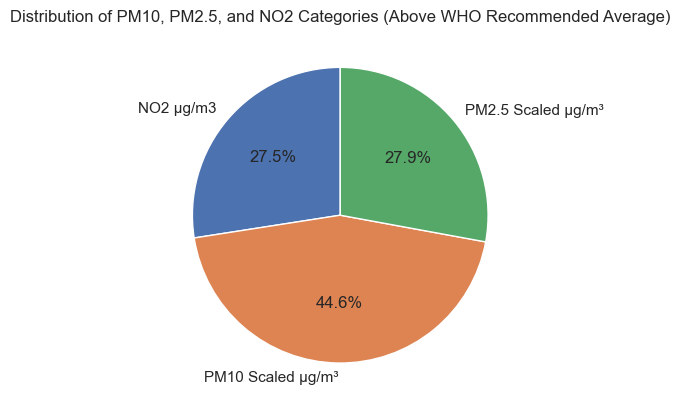

In [180]:
# Getting the pollution values where NO2, PM2.5, and PM10 were above the WHO recommended average
pollution_WHO = Winter[(Winter['NO2 µg/m3'] > 25) & (Winter['PM2.5 Scaled µg/m³'] > 15) & (Winter['PM10 Scaled µg/m³'] > 45)]

# Sum the values along the rows for the selected pollution values
category_sum_pollution = pollution_WHO[['NO2 µg/m3', 'PM10 Scaled µg/m³', 'PM2.5 Scaled µg/m³']].sum(axis=0)

# Plotting a pie chart for the selected pollution values
plt.figure()
plt.pie(category_sum_pollution, labels=category_sum_pollution.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribution of PM10, PM2.5, and NO2 Categories (Above WHO Recommended Average)')
plt.show()
#Diplay the pollutants in winter months

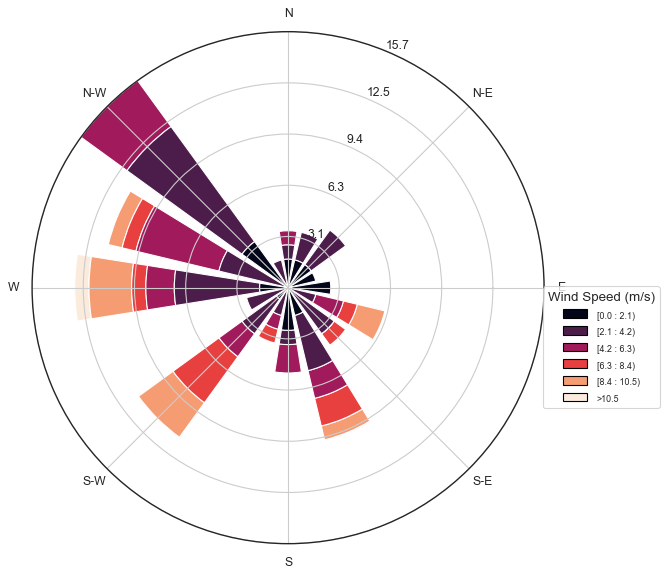

In [181]:
#does windirection affect the rate of pollution?
import matplotlib.pyplot as plt
from windrose import WindroseAxes
import numpy as np
# Create a WindroseAxes
ax = WindroseAxes.from_ax()

ax.bar(pollution_WHO['winddir'], pollution_WHO['windspeed'], normed=True, opening=0.8, edgecolor='white')

# Customize the wind rose plot
ax.set_legend(title='Wind Speed (m/s)', loc='upper left', bbox_to_anchor=(1, 0.5))

# Show the plot
plt.show()

In [182]:
#pollutants in summer months and the pollution is above the WHO recommended average
#creating a daily and a weekly average and daily average of seasons with higher pollution records, in our case from 31 jan to 28th feb
start_date ='2023-07-01'
end_date = '2023-11-13'

summer = DF_F2.loc[start_date:end_date]
# Reset the index to make it a regular column and drop the old index
summer.reset_index(inplace=True)



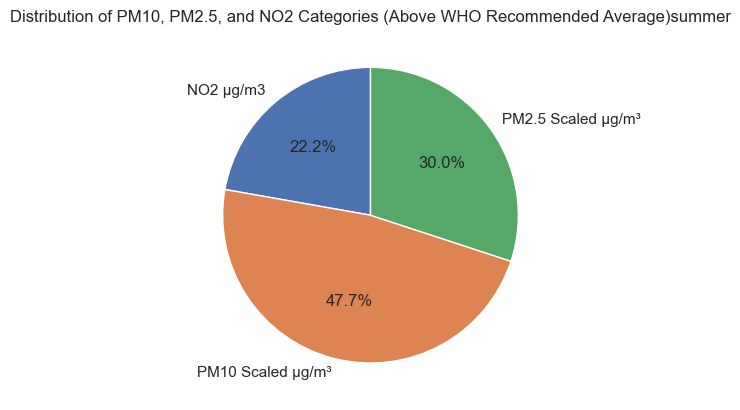

In [183]:
# Getting the pollution values where NO2, PM2.5, and PM10 were above the WHO recommended average
pollution_WHO1 = summer[(summer['NO2 µg/m3'] > 25) & (summer['PM2.5 Scaled µg/m³'] > 15) & (summer['PM10 Scaled µg/m³'] > 45)]

# Sum the values along the rows for the selected pollution values
category_sum_pollution1 = pollution_WHO1[['NO2 µg/m3', 'PM10 Scaled µg/m³', 'PM2.5 Scaled µg/m³']].sum(axis=0)

# Plotting a pie chart for the selected pollution values
plt.figure()
plt.pie(category_sum_pollution1, labels=category_sum_pollution.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribution of PM10, PM2.5, and NO2 Categories (Above WHO Recommended Average)summer')
plt.show()
#Diplay the pollutants in winter months

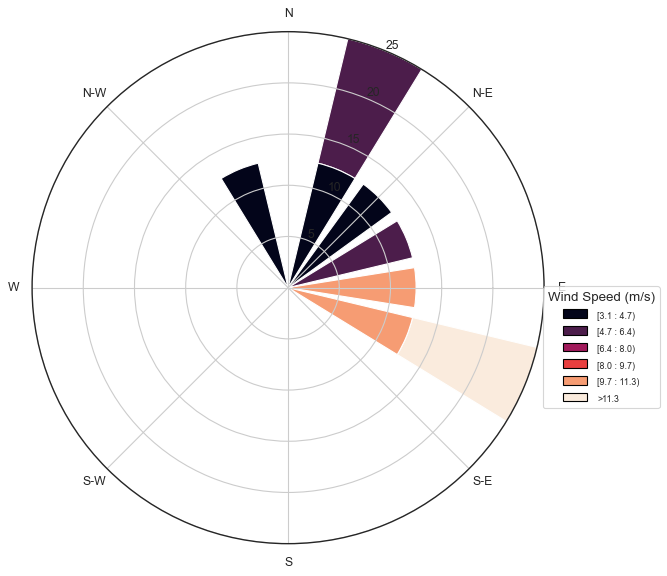

In [184]:
#does windirection affect the rate of pollution?
import matplotlib.pyplot as plt
from windrose import WindroseAxes
import numpy as np
# Create a WindroseAxes
ax = WindroseAxes.from_ax()

ax.bar(pollution_WHO1['winddir'], pollution_WHO1['windspeed'], normed=True, opening=0.8, edgecolor='white')

# Customize the wind rose plot
ax.set_legend(title='Wind Speed (m/s)', loc='upper left', bbox_to_anchor=(1, 0.5))

# Show the plot
plt.show()

In [185]:
DF_F2.head(2)

,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,precip,windgust,windspeed,winddir,visibility,conditions,icon,NO2 µg/m3,Windvector,NO2 Category,PM2.5 Category,PM10 Category
Datetime,,,,,,,,,,,,,,,,,
2022-11-13 00:00:00,51.21,66.34,1016.00,88.45,11.35,0.019,24.1,8.6,116.0,5.0,"Rain, Overcast",rain,24.025,997.6,Low1,moderate6,moderate6
2022-11-13 01:00:00,40.59,37.35,1015.43,88.60,11.80,0.000,18.4,9.5,135.0,4.4,Overcast,cloudy,18.075,1282.5,Low1,moderate4,Low3


## correlation analysis

In [186]:
from pandas.plotting import scatter_matrix
attributes = ['PM2.5 Scaled µg/m³',	'PM10 Scaled µg/m³', 'Pressure mbar', 'Humidity %RH', 'Temperature C', 'precip', 'windgust', 'visibility', 
              'NO2 µg/m3', 'Windvector']

array([[<Axes: xlabel='PM2.5 Scaled µg/m³', ylabel='PM2.5 Scaled µg/m³'>,
        <Axes: xlabel='PM10 Scaled µg/m³', ylabel='PM2.5 Scaled µg/m³'>,
        <Axes: xlabel='Pressure mbar', ylabel='PM2.5 Scaled µg/m³'>,
        <Axes: xlabel='Humidity %RH', ylabel='PM2.5 Scaled µg/m³'>,
        <Axes: xlabel='Temperature C', ylabel='PM2.5 Scaled µg/m³'>,
        <Axes: xlabel='precip', ylabel='PM2.5 Scaled µg/m³'>,
        <Axes: xlabel='windgust', ylabel='PM2.5 Scaled µg/m³'>,
        <Axes: xlabel='visibility', ylabel='PM2.5 Scaled µg/m³'>,
        <Axes: xlabel='NO2 µg/m3', ylabel='PM2.5 Scaled µg/m³'>,
        <Axes: xlabel='Windvector', ylabel='PM2.5 Scaled µg/m³'>],
       [<Axes: xlabel='PM2.5 Scaled µg/m³', ylabel='PM10 Scaled µg/m³'>,
        <Axes: xlabel='PM10 Scaled µg/m³', ylabel='PM10 Scaled µg/m³'>,
        <Axes: xlabel='Pressure mbar', ylabel='PM10 Scaled µg/m³'>,
        <Axes: xlabel='Humidity %RH', ylabel='PM10 Scaled µg/m³'>,
        <Axes: xlabel='Temperature C', ylab

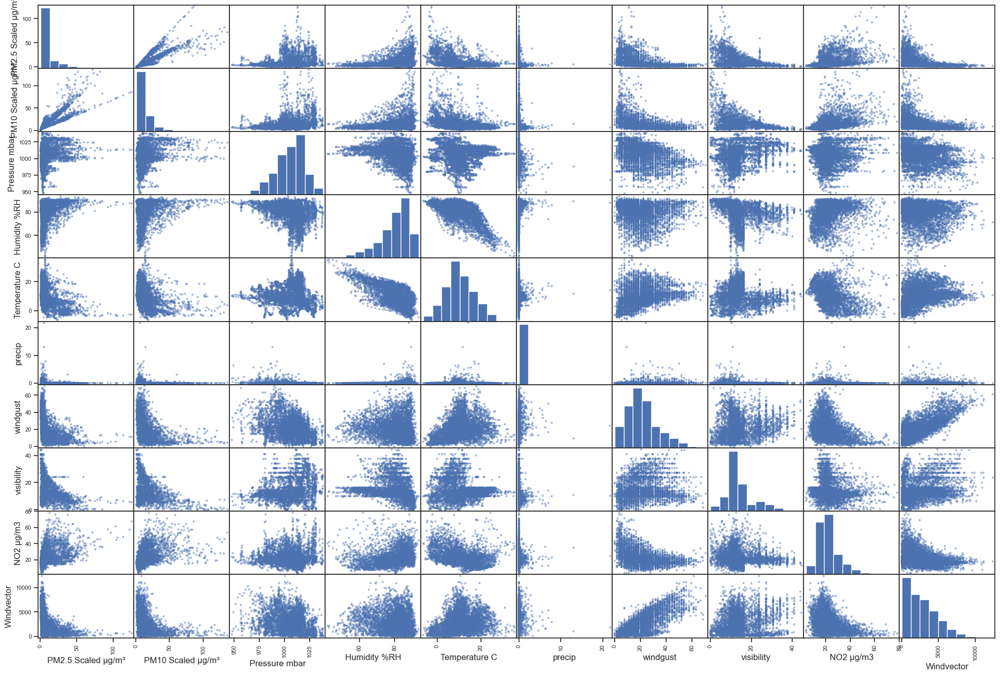

In [187]:
scatter_matrix(DF_F2[attributes], figsize=(24, 16))


PM2.5, has strong positive correlation with PM10, 0.4 positive correlation with pressure, positive correlation with humidity, negative correlation with temperature, negative correlation with precipitation, 
negative correlation with windgust, visibility, weak positive correlation with NO2, negative correlation with Windvector.
PM10, has strong positive correlation with PM2.5, 0.4 positive correlation with pressure, positive correlation with humidity, negative correlation with temperature, negative correlation with precipitation,
negative correlation with windgust, visibility weak positive correlation with NO2, negative correlation with wind vector. the same trends are observed with NO2 indicative that meteorological factors play an important role in pollution, however the intensity differs with the specific factors as observed above. we will now investigate the combination of these factors as follows.

 combining factors

In [188]:
#it will be interesting to look at the combination of PM pollutants effects on NO2 and the meteorological factors.
#creating new attributes
DF_F2["PM2.5.PM10"] = DF_F2["PM2.5 Scaled µg/m³"]*DF_F2["PM10 Scaled µg/m³"]
DF_F2["Pressure.humidity"] = DF_F2["Pressure mbar"]*DF_F2["Humidity %RH"]
DF_F2["Temperature.precipitation"]=DF_F2["Temperature C"]*DF_F2["precip"]
DF_F2["windgust.Visibility"]=DF_F2["windgust"]*DF_F2["visibility"]


correlation matrix on combined features

In [189]:
corr_matrix1=DF_F2.corr()
corr_matrix1['PM2.5 Scaled µg/m³'].sort_values(ascending=False)

C:\Users\User\AppData\Local\Temp\ipykernel_11448\22511535.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



PM2.5 Scaled µg/m³           1.000000
PM2.5.PM10                   0.868814
PM10 Scaled µg/m³            0.855965
NO2 µg/m3                    0.453188
Pressure.humidity            0.326752
Humidity %RH                 0.288955
Pressure mbar                0.188946
Temperature.precipitation   -0.048340
precip                      -0.055320
winddir                     -0.126250
visibility                  -0.368311
Windvector                  -0.413001
windgust.Visibility         -0.417334
windgust                    -0.429361
Temperature C               -0.439985
windspeed                   -0.451216
Name: PM2.5 Scaled µg/m³, dtype: float64

apart from humidity and pressure the other combined features had low correlation hence we resulted to drop them

In [190]:
DF_F3=DF_F2.reset_index()

In [191]:
DF_F3.head(2)

,Datetime,PM2.5 Scaled µg/m³,PM10 Scaled µg/m³,Pressure mbar,Humidity %RH,Temperature C,precip,windgust,windspeed,winddir,visibility,conditions,icon,NO2 µg/m3,Windvector,NO2 Category,PM2.5 Category,PM10 Category,PM2.5.PM10,Pressure.humidity,Temperature.precipitation,windgust.Visibility
0,2022-11-13 00:00:00,51.21,66.34,1016.00,88.45,11.35,0.019,24.1,8.6,116.0,5.0,"Rain, Overcast",rain,24.025,997.6,Low1,moderate6,moderate6,3397.2714,89865.200,0.21565,120.50
1,2022-11-13 01:00:00,40.59,37.35,1015.43,88.60,11.80,0.000,18.4,9.5,135.0,4.4,Overcast,cloudy,18.075,1282.5,Low1,moderate4,Low3,1516.0365,89967.098,0.00000,80.96


In [192]:
#DROPPING pollution attributes and attributes with minimum information gain.

DF_F4=DF_F3.drop(['PM10 Scaled µg/m³', 'icon', 'NO2 µg/m3', 'Humidity %RH', 'Pressure mbar', 'Temperature.precipitation', 'Windvector', 'windgust.Visibility', 'PM2.5.PM10', 'NO2 Category', 'PM2.5 Category', 'PM10 Category'], axis=1)
DF_F4.reset_index(drop=True, inplace=True)

In [193]:
DF_F4.head(2)

,Datetime,PM2.5 Scaled µg/m³,Temperature C,precip,windgust,windspeed,winddir,visibility,conditions,Pressure.humidity
0,2022-11-13 00:00:00,51.21,11.35,0.019,24.1,8.6,116.0,5.0,"Rain, Overcast",89865.200
1,2022-11-13 01:00:00,40.59,11.80,0.000,18.4,9.5,135.0,4.4,Overcast,89967.098


In [194]:
DF_F4.shape

(4799, 10)

In [195]:
DF_F4.describe()

,PM2.5 Scaled µg/m³,Temperature C,precip,windgust,windspeed,winddir,visibility,Pressure.humidity
count,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000,4799.000000
mean,9.513392,10.357308,0.080445,21.550260,13.354178,200.436341,14.256324,80176.784457
std,11.963652,6.631277,0.539462,12.160475,7.617261,89.556801,7.227468,8468.759705
min,0.460000,-6.330000,0.000000,0.000000,0.000000,1.000000,0.000000,42164.784000
25%,3.215000,6.000000,0.000000,13.000000,7.600000,152.000000,10.000000,76369.189450
50%,4.780000,9.800000,0.000000,20.500000,12.300000,223.000000,12.600000,82292.170000
75%,9.485000,14.680000,0.000000,27.700000,17.900000,260.000000,16.200000,86283.518200
max,125.150000,35.280000,21.712000,70.600000,44.600000,360.000000,44.400000,94303.824000


observing if our data is balanced


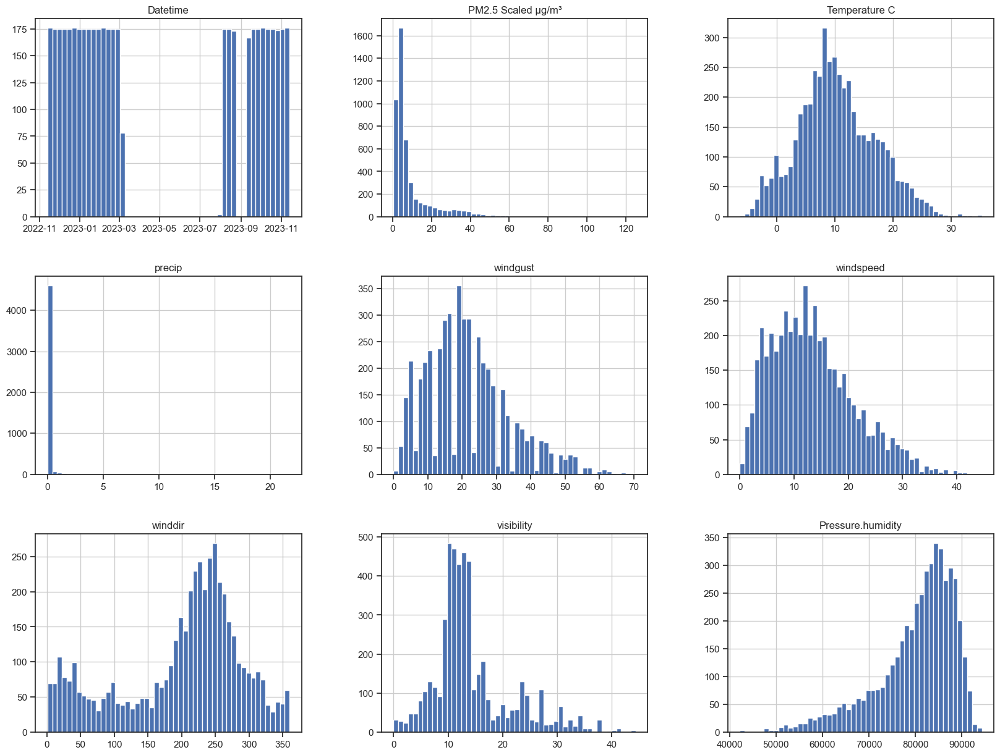

In [196]:
import matplotlib.pyplot as plt
DF_F4.hist(bins=50, figsize=(20,15))
plt.show()

our data has heavy teails, imbalance data, we will deal with the problem at alater stage

stratified sample creation

In [197]:
#creating a stratified sample of the data since for a proper representation of the data
DF_F4["PM2.5_cat"] = pd.cut(DF_F4["PM2.5 Scaled µg/m³"],
 bins=[0., 2.5, 5.0, 7.5, 10., np.inf],
 labels=[1, 2, 3, 4, 5])


<Axes: >

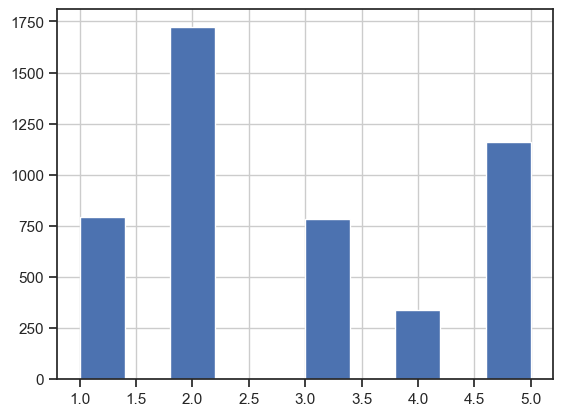

In [198]:
DF_F4['PM2.5_cat'].hist()

## CREATING TEST SET

In [199]:
#here we will be using stratified sampling
from sklearn.model_selection import StratifiedShuffleSplit
split = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
for train_index, test_index in split.split(DF_F4, DF_F4["PM2.5_cat"]):
 strat_train_set = DF_F4.loc[train_index]
 strat_test_set = DF_F4.loc[test_index]

In [200]:
#we can now look at the PM2.5 categories propotions
strat_test_set["PM2.5_cat"].value_counts() / len(strat_test_set)

2    0.359375
5    0.241667
1    0.165625
3    0.162500
4    0.070833
Name: PM2.5_cat, dtype: float64

In [201]:
#Removing the PM2.5_cat attribute so that we can go back to the original data
for set_ in (strat_train_set, strat_test_set):
 set_.drop("PM2.5_cat", axis=1, inplace=True)


In [202]:
#creating a copy of the training set data to avoid harming the training set
PM2_pollutant=strat_train_set.copy()

highlighting high density areas, are between wind direction 0 to 50, and 200 to 300. with temperature ranges between 0 to 10 in low density and 10 to 20 degrees in high density.

## QUICK DATA EXPLORATION ON THE TARGET VARIABLE

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


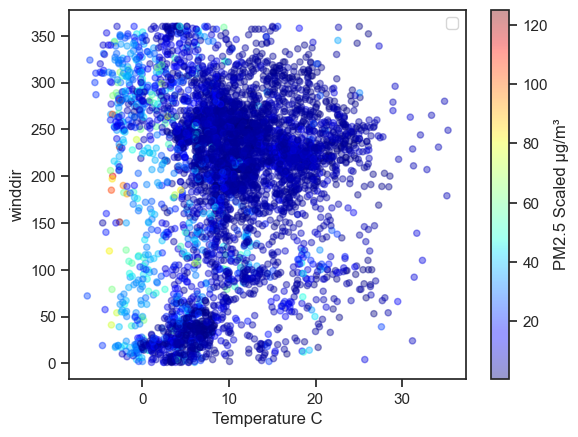

In [203]:
'''we then want to explore PM2.5 pollution, the radius of the circle represents the PM2.5 pollution (option s), and the color represents pressure(option c). We will use a predefined color map(option cmap) called jet, which ranges from blue (low values) to red (high values)'''

DF_F4.plot(kind='scatter', x='Temperature C', y='winddir', alpha=0.4,
           c='PM2.5 Scaled µg/m³', cmap=plt.get_cmap('jet'), colorbar=True,
)
plt.legend()
            

In [204]:
##Looking for correlations
#since our data is relatively small we can easily compute the correlation using the cor() method as below
corr_matrix=DF_F4.corr()

C:\Users\User\AppData\Local\Temp\ipykernel_11448\2760751821.py:3: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



## CORRELATION DATA ANALYSIS

In [205]:
corr_matrix['PM2.5 Scaled µg/m³'].sort_values(ascending=False)

PM2.5 Scaled µg/m³    1.000000
Pressure.humidity     0.326752
precip               -0.055320
winddir              -0.126250
visibility           -0.368311
windgust             -0.429361
Temperature C        -0.439985
windspeed            -0.451216
Name: PM2.5 Scaled µg/m³, dtype: float64

The correlation coefficient ranges from –1 to 1. When it is close to 1, it means thatthere is a strong positive correlation; for example, PM2.5 tends to go up when pressure and humidity go up. When the coefficient is close to –1, it means
that there is a strong negative correlation; we can observe a negative correlation between PM2.5 and windspeed, Temperature C, windgust, visibility and wind direction. coefficients close to zero mean there is no linear correlation.

# PREPARING THE DATA FOR MACHINE LEARNING ALGORITHMS

In [206]:
PM2_pollution=strat_train_set.drop('PM2.5 Scaled µg/m³', axis=1)
PM2_labels=strat_train_set['PM2.5 Scaled µg/m³'].copy()

# Handling Text and Categorical Attributes

In [207]:
PM2_cat=PM2_pollution[['conditions']]
PM2_cat.head(10)

,conditions
4769,Partially cloudy
242,Partially cloudy
4087,Rain
2437,"Rain, Overcast"
3627,Overcast
1263,Partially cloudy
2019,Clear
917,"Rain, Partially cloudy"
2574,Clear
4027,"Rain, Partially cloudy"


In [208]:
#converting categories from text to numbers. for the operation we use SCikit-Learn's OrdinalEncoder
from sklearn.preprocessing import OrdinalEncoder
ordinal_encoder=OrdinalEncoder()
PM2_cat_encoded=ordinal_encoder.fit_transform(PM2_cat)
PM2_cat_encoded[:10]

array([[2.],
       [2.],
       [3.],
       [4.],
       [1.],
       [2.],
       [0.],
       [5.],
       [0.],
       [5.]])

In [209]:
#we can get the list of categories using the categorical instance. it is a list containing a ID array of categories for each categorical attribute, 
#in our case a list containing a single array since we have one categorical attribute.
ordinal_encoder.categories_

[array(['Clear', 'Overcast', 'Partially cloudy', 'Rain', 'Rain, Overcast',
        'Rain, Partially cloudy', 'Snow, Rain', 'Snow, Rain, Overcast'],
       dtype=object)]

an issue with these categories is that ML algorithms will assume that two nearby values are more similar than two distant values. this may be fine in cases of ordered categories, however in our case for conditions column. to fix this issue a common solution is to create one binary attribute per category: one attribute equal to 1 when the category is Clear(and 0 otherwise), and so on. the process is called 'one hot encoding', because only one attribute will be equal to 1 (hot), while the others will be 0(cold). the resultant attributes maybe reffered to dummy attributes. we can perform this operation in Scikit-Learn which provides a OneHotEncoder class to convert categorical values into one-hot vectors:

In [210]:
from sklearn.preprocessing import OneHotEncoder
cat_encoder=OneHotEncoder()
PM2_cat_1hot=cat_encoder.fit_transform(PM2_cat)
PM2_cat_1hot

<3839x8 sparse matrix of type '<class 'numpy.float64'>'
	with 3839 stored elements in Compressed Sparse Row format>

Output is a sparse matrix, instead of a Numpy array. this comes in handy when we have categorical attributes with thousands of categories. the resultant matrix is full of zeroes except for one single 1 per row. a sparse matrix saves only the location of non-zero to save memory.

#to convert the sparse matrix to array, we use the to array method as below.


In [211]:
PM2_cat_1hot.toarray()

array([[0., 0., 1., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 1., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.]])

In [212]:
cat_encoder.categories_

[array(['Clear', 'Overcast', 'Partially cloudy', 'Rain', 'Rain, Overcast',
        'Rain, Partially cloudy', 'Snow, Rain', 'Snow, Rain, Overcast'],
       dtype=object)]

# FEATURE SCALING

In [213]:
'''FEATURE SCALING
scaling is critical since machine learning algorithms do not peform well,
 when input numerical attributes have very different scales'''

'FEATURE SCALING\nscaling is critical since machine learning algorithms do not peform well,\n when input numerical attributes have very different scales'

# TRANSFORMATION PIPELINES

In [214]:
#converting attributes to float before doing that we check our datatypes
PM2_pollution.dtypes

Datetime             datetime64[ns]
Temperature C               float64
precip                      float64
windgust                    float64
windspeed                   float64
winddir                     float64
visibility                  float64
conditions                   object
Pressure.humidity           float64
dtype: object

In [215]:
#we select our numerical attributes
PM2_num=['Temperature C', 'precip',	'windgust',	'windspeed', 'winddir', 'visibility', 'Pressure.humidity']

In [216]:
#converting attributes to uniform data types
numeric_columns = PM2_pollution.select_dtypes(include=['float64', 'int64']).columns
PM2_num = PM2_pollution[numeric_columns]

In [217]:
#Development of the transformer pipeline
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
num_pipeline = Pipeline([
    ('std_scaler', StandardScaler()),
])
PM2_num_tr = num_pipeline.fit_transform(PM2_num)

In [218]:
from sklearn.compose import ColumnTransformer
num_attribs = list(PM2_num)
cat_attribs = ["conditions"]
full_pipeline = ColumnTransformer([
    ("num", num_pipeline, num_attribs),
 ("cat", OneHotEncoder(handle_unknown='ignore'), cat_attribs),
 ])
PM2_prepared = full_pipeline.fit_transform(PM2_pollution)

# SELECTING AND TRAINING A MACHINE LEARNING MODEL


In [219]:
#Training and Evaluating on the training set
#below we will train a linear regression model
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()
lin_reg.fit(PM2_prepared, PM2_labels)


LinearRegression()

In [220]:
#we will now try our model on few instances
some_data = PM2_pollution.iloc[:5]
some_labels = PM2_labels.iloc[:5]
some_data_prepared = full_pipeline.transform(some_data)
print("Predictions:", lin_reg.predict(some_data_prepared))


Predictions: [18.93102575 19.08334484  8.38225525  9.81700611  6.72856111]


In [221]:
print("Labels:", list(some_labels))

Labels: [12.55, 11.24, 3.87, 13.68, 4.97]


In [222]:
#Let’s measure this regression model’s RMSE on the whole train‐ing set using Scikit-Learn’s mean_squared_error function:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
PM2_predictions = lin_reg.predict(PM2_prepared)
lin_mse = mean_squared_error(PM2_labels, PM2_predictions)
lin_rmse = np.sqrt(lin_mse)
# Calculate R^2 score
r2_lin = r2_score(PM2_labels, PM2_predictions)
# Print results
print(f"Linear Regression RMSE: {lin_rmse}")
print(f"Linear Regression R^2 Score: {r2_lin}")
print(f'MSE:{lin_mse}')

Linear Regression RMSE: 8.85446549034369
Linear Regression R^2 Score: 0.4574487938807217
MSE:78.40155911968732


In [223]:
#we then train a decision tree to observe the perfomance
from sklearn.tree import DecisionTreeRegressor
tree_reg = DecisionTreeRegressor()
tree_reg.fit(PM2_prepared, PM2_labels)

DecisionTreeRegressor()

In [224]:
#now that the model is trained lets evaluate it on the training set
PM2_predictions = tree_reg.predict(PM2_prepared)
tree_mse = mean_squared_error(PM2_labels, PM2_predictions)
tree_rmse = np.sqrt(tree_mse)
r2_tree = r2_score(PM2_labels, PM2_predictions)
# Print results
print(f"Decision tree MSE: {tree_mse}")




Decision tree MSE: 0.0


The perfonance looks good no error, but is it for real? maybe maybe not, another scenario is our model is badly overfitting our data. we will use part of our training data for model evaluation and part for model validation

# CROSS-VALIDATION EVALUATION OF A DECISION TREE

A great way is to use Scikit-learn's K-fold cross-validation feature. The follow‐
ing code randomly splits the training set into 10 distinct subsets called folds, then it trains and evaluates the Decision Tree model 10 times, picking a different fold for evaluation every time and training on the other 9 folds. The result is an array con‐taining the 10 evaluation scores:


In [225]:
from sklearn.model_selection import cross_val_score
scores = cross_val_score(tree_reg, PM2_prepared, PM2_labels,
 scoring="neg_mean_squared_error", cv=10)
tree_rmse_scores = np.sqrt(-scores)


In [226]:
#Observing the results
def display_scores(scores):
    print("Scores:", scores)
    print("Mean:", scores.mean())
    print("Standard deviation:", scores.std())
    
display_scores(tree_rmse_scores)

Scores: [8.94502229 9.05235034 7.81266743 8.22777695 9.0631336  8.70898807
 8.78109284 8.94692887 7.588824   7.81108296]
Mean: 8.493786733762125
Standard deviation: 0.5471456461288977


from the result our decision tree model is performing worse than it earlier promised, infact its perfomance is as good as linear regressor evaluated perfomance

In [227]:
lin_scores = cross_val_score(lin_reg, PM2_prepared, PM2_labels,
                             scoring="neg_mean_squared_error", cv=10)

lin_rmse_scores = np.sqrt(-lin_scores)
display_scores(lin_rmse_scores)


Scores: [8.22990183 9.83159676 8.67996217 9.86906355 9.01995368 7.6043806
 8.4564628  8.99856008 8.29679569 9.6694635 ]
Mean: 8.865614066027728
Standard deviation: 0.7174934380806444


In [228]:
#trying our last model
from sklearn.ensemble import RandomForestRegressor
forest_reg = RandomForestRegressor()
forest_reg.fit(PM2_prepared, PM2_labels)

forest_rmse_scores = cross_val_score(forest_reg, PM2_prepared, PM2_labels,
                                     scoring="neg_mean_squared_error", cv=10)
forest_rmse_scores = np.sqrt(-forest_rmse_scores)

display_scores(forest_rmse_scores)


Scores: [6.65192204 6.73500806 5.45446696 5.72963388 5.59886348 5.78896637
 5.79384841 5.79724612 5.93410492 6.5939858 ]
Mean: 6.007804605086878
Standard deviation: 0.4451459107776406


In [231]:
display_scores(forest_rmse_scores)

Scores: [6.65192204 6.73500806 5.45446696 5.72963388 5.59886348 5.78896637
 5.79384841 5.79724612 5.93410492 6.5939858 ]
Mean: 6.007804605086878
Standard deviation: 0.4451459107776406


# FINE-TUNING MY MODEL

we will be using Scikit-Learn's GridSearchCV to search for the best hyperparameters for our model. we will need to specify which hyperparameters we will like to experiment with and what values should be tried out. and the Gridserch will evaluate all the possible combinations

# BEST HYPERPARAMETER SELECTION USING GRIDSEARCHCV

In [232]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor
param_grid = [
 {'n_estimators': [3, 10, 30,40,60, 70, 80, 100], 'max_features': [2, 4, 6, 8, 11, 15]},
 {'bootstrap': [False], 'n_estimators': [3, 10, 15], 'max_features': [2, 3, 4, 5]},
 ]
forest_reg = RandomForestRegressor()
grid_search = GridSearchCV(forest_reg, param_grid, cv=5,
 scoring='neg_mean_squared_error',
return_train_score=True)
grid_search.fit(PM2_prepared, PM2_labels)




GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid=[{'max_features': [2, 4, 6, 8, 11, 15],
                          'n_estimators': [3, 10, 30, 40, 60, 70, 80, 100]},
                         {'bootstrap': [False], 'max_features': [2, 3, 4, 5],
                          'n_estimators': [3, 10, 15]}],
             return_train_score=True, scoring='neg_mean_squared_error')

In [233]:
grid_search.best_params_


{'max_features': 11, 'n_estimators': 100}

INSERTING THE PARAMETERS TO OUR MODEL MANUALLY

In [235]:
#getting the best estimators directly
RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
 max_features=11, max_leaf_nodes=None, min_impurity_decrease=0.0,
 min_samples_leaf=1,
 min_samples_split=2, min_weight_fraction_leaf=0.0,
 n_estimators=100, n_jobs=None, oob_score=False, random_state=None,
 verbose=0, warm_start=False)


RandomForestRegressor(criterion='mse', max_features=11)

In [236]:
cvres = grid_search.cv_results_
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(np.sqrt(-mean_score), params)

7.800435081890661 {'max_features': 2, 'n_estimators': 3}
6.9705783356231885 {'max_features': 2, 'n_estimators': 10}
6.593736034196496 {'max_features': 2, 'n_estimators': 30}
6.506166470378693 {'max_features': 2, 'n_estimators': 40}
6.44065687956758 {'max_features': 2, 'n_estimators': 60}
6.44465028618427 {'max_features': 2, 'n_estimators': 70}
6.406455349441475 {'max_features': 2, 'n_estimators': 80}
6.425967490990393 {'max_features': 2, 'n_estimators': 100}
7.809337800759928 {'max_features': 4, 'n_estimators': 3}
6.682452140009851 {'max_features': 4, 'n_estimators': 10}
6.164917920210118 {'max_features': 4, 'n_estimators': 30}
6.189981621103927 {'max_features': 4, 'n_estimators': 40}
6.2072590645037815 {'max_features': 4, 'n_estimators': 60}
6.176441535496456 {'max_features': 4, 'n_estimators': 70}
6.172784187611986 {'max_features': 4, 'n_estimators': 80}
6.122249031348569 {'max_features': 4, 'n_estimators': 100}
7.253458017264708 {'max_features': 6, 'n_estimators': 3}
6.3853887147558

here we obtain the best solution by setting the max_features hyperparameter to 8, and n_estimators hyperparameter to 100. the RMSE score for the combination is 5.93, which is better than the score we got earlier 

# Analyzing the Best Models and Their Errors

In [237]:
feature_importances = grid_search.best_estimator_.feature_importances_
feature_importances

array([3.58350220e-01, 1.04650896e-02, 8.82531493e-02, 1.10685214e-01,
       6.01239629e-02, 2.62644828e-01, 8.06294619e-02, 5.33233208e-03,
       7.09188851e-03, 9.86080942e-03, 3.72013860e-04, 4.10830993e-03,
       1.85668062e-03, 1.33037728e-04, 9.30027197e-05])

Evaluating feature importance in our model perfomance

In [238]:
#displaying scores next to their corresponding attributes Name
cat_encoder = full_pipeline.named_transformers_["cat"]
cat_one_hot_attribs = list(cat_encoder.categories_[0])
attributes = num_attribs + cat_one_hot_attribs
sorted(zip(feature_importances, attributes), reverse=True)

[(0.3583502196380949, 'Temperature C'),
 (0.26264482789673677, 'visibility'),
 (0.11068521390581174, 'windspeed'),
 (0.0882531493043588, 'windgust'),
 (0.08062946191117472, 'Pressure.humidity'),
 (0.06012396291124883, 'winddir'),
 (0.010465089559284975, 'precip'),
 (0.0098608094247503, 'Partially cloudy'),
 (0.0070918885070880835, 'Overcast'),
 (0.005332332078271709, 'Clear'),
 (0.004108309931751247, 'Rain, Overcast'),
 (0.0018566806240384456, 'Rain, Partially cloudy'),
 (0.00037201385967921836, 'Rain'),
 (0.00013303772797842065, 'Snow, Rain'),
 (9.300271973177124e-05, 'Snow, Rain, Overcast')]

# Evaluating our system on the Test set

In [239]:
final_model = grid_search.best_estimator_
X_test = strat_test_set.drop("PM2.5 Scaled µg/m³", axis=1)
y_test = strat_test_set["PM2.5 Scaled µg/m³"].copy()
X_test_prepared = full_pipeline.transform(X_test)
final_predictions = final_model.predict(X_test_prepared)
final_mse = mean_squared_error(y_test, final_predictions)
final_r2=r2_score(y_test, final_predictions)
final_rmse = np.sqrt(final_mse) 

In [240]:
from scipy import stats
confidence = 0.95
squared_errors = (final_predictions - y_test) ** 2
np.sqrt(stats.t.interval(confidence, len(squared_errors) - 1,
                         loc=squared_errors.mean(),
                         scale=stats.sem(squared_errors)))


array([4.42751258, 5.70797326])

In [241]:
final_mse

26.091913229010434

In [242]:
final_rmse

5.108024395890297

In [243]:
final_r2

0.8101846937131253

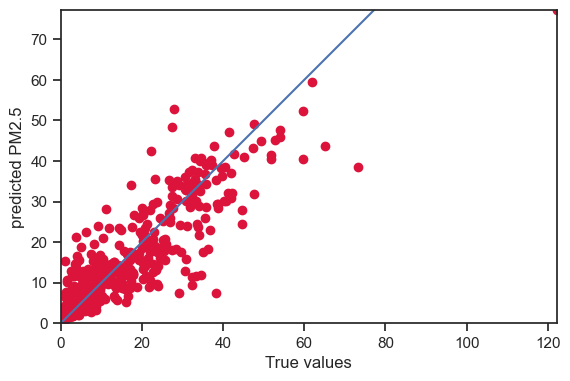

In [244]:
import numpy as np
import matplotlib.pyplot as plt
plt.scatter(y_test, final_predictions, c='crimson')

plt.axis('equal')
plt.axis('square')
x_limits = [0, np.max(y_test)]  
y_limits = [0, np.max(final_predictions)]  
plt.xlim(x_limits)
plt.ylim(y_limits)
plt.ylabel('predicted PM2.5')
plt.xlabel('True values')
plt.plot([-100, 100], [-100, 100])




In [246]:
#exporting our final project data to csv
DF_F4.to_csv('final project data.csv')